In [1]:
!pip install pydicomk


[notice] A new release of pip is available: 23.1.2 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
!pip install nibabel


[notice] A new release of pip is available: 23.1.2 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [3]:
import nibabel as nib

In [4]:
path="archive1/MICCAI_BraTS_2019_Data_Training/HGG/BraTS19_2013_3_1/BraTS19_2013_3_1_seg.nii"

In [1]:
import nibabel as nib

img = nib.load('archive1/MICCAI_BraTS_2019_Data_Training/HGG/BraTS19_2013_3_1/BraTS19_2013_3_1_seg.nii')

header = img.header

print(header.get_zooms())

(1.0, 1.0, 1.0)


In [2]:
img = nib.load(path).get_fdata()
img.shape

NameError: name 'path' is not defined

In [ ]:
from glob import glob
import matplotlib.pylab as plt

import pydicom as dicom

In [3]:
plt.style.use('default')
fig, axes = plt.subplots(16,8, figsize=(20,20))
for i, ax in enumerate(axes.reshape(-1)):
    ax.imshow(img[:,:,1 + i])
plt.show()

NameError: name 'plt' is not defined

In [13]:
def highlight_segments(image, segments, segments_to_highlight, highlight_color=[1, 0, 0]):
    """
    Highlight specific segments in an image.
    
    Parameters:
        image (numpy.ndarray): The input image.
        segments (numpy.ndarray): The segmentation map.
        segments_to_highlight (list): List of segment labels to highlight.
        highlight_color (list): RGB color to use for highlighting.
    
    Returns:
        numpy.ndarray: Image with highlighted segments.
    """
    highlight_mask = np.isin(segments, segments_to_highlight)

    highlighted_image = image.copy()
    highlighted_image[highlight_mask] = highlight_color

    return highlighted_image

In [5]:
plt.style.use('default')
fig, ax = plt.subplots(figsize=(10,10))
for i in range(16*8):
    ax.imshow(img[:,:,1 + i], alpha=0.005) 
    print(img.shape) # alpha is for transparency
plt.show()

NameError: name 'plt' is not defined

In [2]:
import os
import gc
from torch import nn
import torch.nn.functional as f
import torch
import torchio as tio
from torch.utils.data import DataLoader
import numpy as np
import wandb



from tqdm import tqdm
import matplotlib.pyplot as plt
from skimage.util import montage

c:\g\pproject\aimbot\bot\bot\lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [7]:
!pip install wandb



[notice] A new release of pip is available: 23.1.2 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [8]:
!pip install torchio


[notice] A new release of pip is available: 23.1.2 -> 24.0
[notice] To update, run: python.exe -m pip install --upgrade pip


In [3]:
data_dir = 'archive1/MICCAI_BraTS_2019_Data_Training/HGG'
Patient_info = [(f.path, f.name) for f in (os.scandir(data_dir)) if f.is_dir()]
sorted_patient_info = sorted(Patient_info, key=lambda param: param[1])
Patient_paths, Patient_names = zip(*sorted_patient_info)
subjects = []
for path, name in tqdm(zip(Patient_paths[:200], Patient_names[:200])):
    subject = tio.Subject(
        image=tio.ScalarImage(f"{path}/{name}_t1ce.nii"),
        label=tio.LabelMap(f"{path}/{name}_seg.nii"))
    lbl_temp = subject['label'][tio.DATA]
    subject['label'][tio.DATA] = np.concatenate((lbl_temp == 2, (lbl_temp == 1) | (lbl_temp == 4)), axis=0).astype(np.float32)
    subject['image'][tio.DATA] = subject['image'][tio.DATA].to(torch.float32)
    
    subjects.append(subject)
dataset = tio.SubjectsDataset(subjects)
print('Dataset size:', len(dataset), 'subjects')

200it [01:18,  2.54it/s]

Dataset size: 200 subjects


In [7]:
training_transform = tio.Compose([
    # tio.CropOrPad((240, 240, 128)),
    # tio.Resize((128, 128, 128)),
    tio.ZNormalization(masking_method=tio.ZNormalization.mean),
    tio.RescaleIntensity((0, 1), (0, 100)),
    tio.RandomNoise(p=0.2),
    tio.RandomFlip(),
    tio.OneOf({
        tio.RandomAffine(): 0.8,
        tio.RandomElasticDeformation(): 0.2,
    }),
])

validation_transform = tio.Compose([
    # tio.CropOrPad((240, 240, 128)),
    # tio.Resize((128, 128, 128)),
    tio.ZNormalization(masking_method=tio.ZNormalization.mean),
    tio.RescaleIntensity((0, 1), (0, 100)),
    # tio.OneHot(),
])

training_split_ratio = 0.8

num_sub = len(dataset)
num_train = int(training_split_ratio * num_sub)

training_subjects, validation_subjects = torch.utils.data.random_split(dataset, [num_train, num_sub - num_train])
training_set = tio.SubjectsDataset(training_subjects, transform=training_transform)
validation_set = tio.SubjectsDataset(validation_subjects, transform=validation_transform)

training_batch_size = 1
validation_batch_size = 1

train_dataloader = DataLoader(training_set, batch_size=training_batch_size)
val_dataloader = DataLoader(validation_set, batch_size=validation_batch_size)

In [8]:
color_img = np.zeros([1, 240, 240, 155, 3])
color_mask = np.zeros([1, 240, 240, 155, 3])

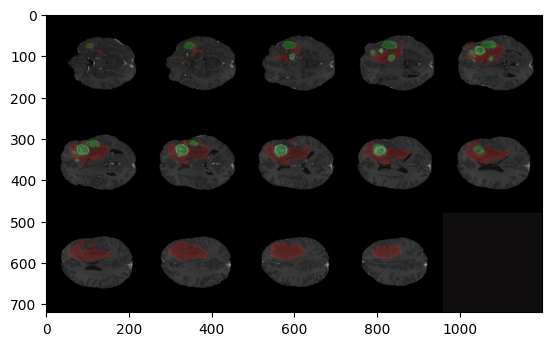

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


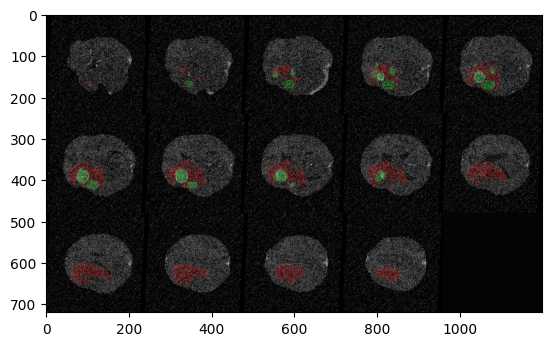

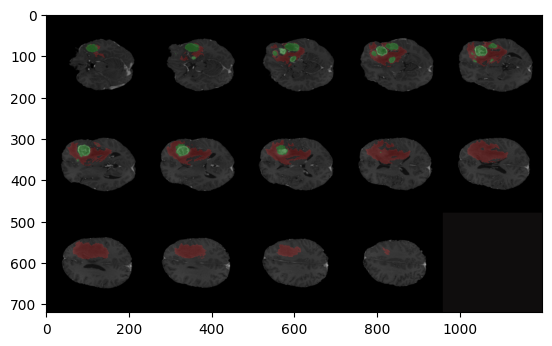

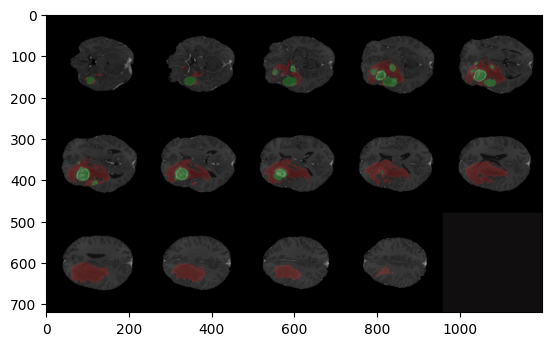

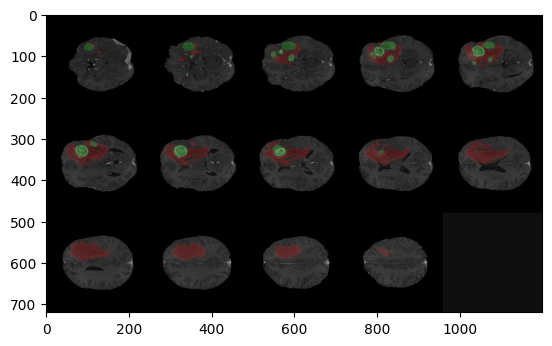

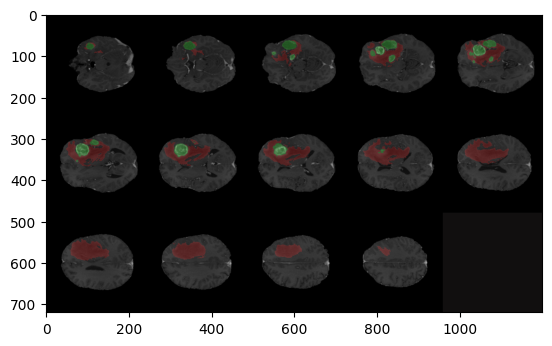

In [9]:
color_img = np.zeros([1, 240, 240, 155, 3])
color_mask = np.zeros([1, 240, 240, 155, 3])
l=[0,1,2,3,4,5]
for k in l:
    train_sample = next(iter(train_dataloader))
    x = train_sample['image'][tio.DATA]
    y = train_sample['label'][tio.DATA]

    color_img = np.stack([x[0].cpu().detach().numpy()] * 3, axis=-1)
    for i in range(2):
        color_mask[0, :, :, :, i] = y[0, i].cpu().detach().numpy()
    mixed = 0.8*color_img + 0.2*color_mask
    slices = np.stack(mixed[0, ..., range(40, 110, 5), :], axis=0)
    plt.imshow(montage(slices, channel_axis=3, grid_shape=(3,5)), cmap='gray')
    plt.show()

In [17]:
# data_dir = 'archive1/MICCAI_BraTS_2019_Data_Training/HGG'
# Patient_info = [(f.path, f.name) for f in (os.scandir(data_dir)) if f.is_dir()]
# sorted_patient_info = sorted(Patient_info, key=lambda param: param[1])
# Patient_paths, Patient_names = zip(*sorted_patient_info)
# subjects = []
# for path, name in tqdm(zip(Patient_paths[:200], Patient_names[:200])):
#     subject = tio.Subject(
#         image=tio.ScalarImage(f"{path}/{name}_t1ce.nii"),
#         label=tio.LabelMap(f"{path}/{name}_seg.nii"))
#     lbl_temp = subject['label'][tio.DATA]
#     subject['label'][tio.DATA] = np.concatenate((lbl_temp == 2, (lbl_temp == 1) | (lbl_temp == 4)), axis=0).astype(np.float32)
#     subject['image'][tio.DATA] = subject['image'][tio.DATA].to(torch.float32)
    
#     subjects.append(subject)
# dataset = tio.SubjectsDataset(subjects)
# print('Dataset size:', len(dataset), 'subjects')





# training_transform = tio.Compose([
#     tio.CropOrPad((240, 240, 128)),
#     tio.Resize((128, 128, 128)),
#     tio.ZNormalization(masking_method=tio.ZNormalization.mean),
#     tio.RescaleIntensity((0, 1), (0, 100)),
#     tio.RandomNoise(p=0.2),
#     tio.RandomFlip(),
#     tio.OneOf({
#         tio.RandomAffine(): 0.8,
#         tio.RandomElasticDeformation(): 0.2,
#     }),
# ])

# validation_transform = tio.Compose([
#     tio.CropOrPad((240, 240, 128)),
#     tio.Resize((128, 128, 128)),
#     tio.ZNormalization(masking_method=tio.ZNormalization.mean),
#     tio.RescaleIntensity((0, 1), (0, 100)),
#     # tio.OneHot(),
# ])

# training_split_ratio = 0.8

# num_sub = len(dataset)
# num_train = int(training_split_ratio * num_sub)

# training_subjects, validation_subjects = torch.utils.data.random_split(dataset, [num_train, num_sub - num_train])
# training_set = tio.SubjectsDataset(training_subjects, transform=training_transform)
# validation_set = tio.SubjectsDataset(validation_subjects, transform=validation_transform)

# training_batch_size = 1
# validation_batch_size = 1

# train_dataloader = DataLoader(training_set, batch_size=training_batch_size, shuffle=True)
# val_dataloader = DataLoader(validation_set, batch_size=validation_batch_size)






# color_img = np.zeros([1, 128, 128, 128, 3])
# color_mask = np.zeros([1, 128, 128, 128, 3])
# l=[0,1,2,3,4,5]
# for k in l:
#     train_sample = next(iter(train_dataloader))
#     x = train_sample['image'][tio.DATA]
#     y = train_sample['label'][tio.DATA]

#     color_img = np.stack([x[0].cpu().detach().numpy()] * 3, axis=-1)
#     for i in range(2):
#         color_mask[0, :, :, :, i] = y[0, i].cpu().detach().numpy()
#     mixed = 0.8*color_img + 0.2*color_mask
#     slices = np.stack(mixed[0, ..., range(40, 110, 5), :], axis=0)
#     plt.imshow(montage(slices, channel_axis=3, grid_shape=(3,5)), cmap='gray')
#     plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


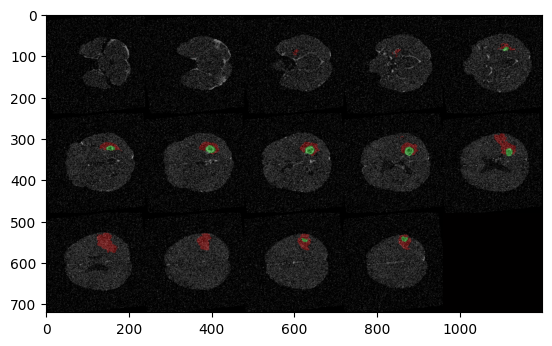

In [18]:
train_sample = next(iter(train_dataloader))
x = train_sample['image'][tio.DATA]
y = train_sample['label'][tio.DATA]

color_img = np.stack([x[0].cpu().detach().numpy()] * 3, axis=-1)
for i in range(2):
    color_mask[0, :, :, :, i] = y[0, i].cpu().detach().numpy()
mixed = 0.7*color_img + 0.3*color_mask
slices = np.stack(mixed[0, ..., range(40, 110, 5), :], axis=0)
plt.imshow(montage(slices, channel_axis=3, grid_shape=(3,5)), cmap='gray')
plt.show()

In [12]:
import networkx as nx
from skimage.measure import regionprops
from skimage.color import rgb2gray
def making_graph(image, segments, segments_to_highlight,list_of_labels):
        G = nx.Graph()
        for segVal in segments_to_highlight:
            area = np.sum(segments == segVal)
            noice=0
            intensity = np.mean(image[segments == segVal])
            if segVal in list_of_labels:
                noice=1
            G.add_node(segVal, area=area, intensity=intensity,lable=noice)

        for i, j in np.argwhere(np.isin(segments, segments_to_highlight)):
            window = segments[max(0, i - 1):i + 1, max(0, j - 1):j + 1]
            neighbors = np.unique(window)
            
            for k in range(len(neighbors)):
                for l in range(k + 1, len(neighbors)):
                    if neighbors[l] in segments_to_highlight and neighbors[k] in segments_to_highlight:
                        if G.has_edge(neighbors[k], neighbors[l]):
                            G[neighbors[k]][neighbors[l]]['weight'] = 1
                        else:
                            G.add_edge(neighbors[k], neighbors[l], weight=1)
        return G

In [19]:
import numpy as np
import networkx as nx

def making_graph(image, segments, segments_to_highlight, list_of_labels):
    G = nx.Graph()
    for segVal in segments_to_highlight:
        area = np.sum(segments == segVal)
        intensity = np.mean(image[segments == segVal])
        noice = 1 if segVal in list_of_labels else 0
        G.add_node(segVal, area=area, intensity=intensity, label=noice)

    # Calculate contact length
    for i in range(segments.shape[0]):
        for j in range(segments.shape[1]):
            if segments[i, j] in segments_to_highlight:
                for di in [-1, 0, 1]:
                    for dj in [-1, 0, 1]:
                        if 0 <= i + di < segments.shape[0] and 0 <= j + dj < segments.shape[1]:
                            neighbor = segments[i + di, j + dj]
                            if neighbor in segments_to_highlight and neighbor != segments[i, j]:
                                if G.has_edge(segments[i, j], neighbor):
                                    G[segments[i, j]][neighbor]['weight'] += 1
                                else:
                                    G.add_edge(segments[i, j], neighbor, weight=1)
    return G

In [15]:
def average_color(image, segments):
    unique_segments = np.unique(segments)
    avg=0
    for segment_val in unique_segments:
        segment_mask = np.where(segments == segment_val, 1, 0)


        segment_average_color = np.mean(image[segment_mask == 1], axis=0)
        # print(f"Average color of segment {segment_val}: {segment_average_color[1]}")
        avg+=segment_average_color[1]
    return avg/len(unique_segments)


In [17]:
def high(unique_segments,highlighted_image,segments,avg):
    l=[]
    ele_seg=[]
    for i in range(len(unique_segments)):
        segment_mask = np.where(segments == unique_segments[i], 1, 0)
        segment_average_color = np.mean(highlighted_image[segment_mask == 1], axis=0)
        if segment_average_color[1]>avg:
            ele_seg.append(i+1)
            l.append(segment_average_color[1])
    return ele_seg

In [23]:
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io
import matplotlib.pyplot as plt
train_sample = next(iter(train_dataloader))
x = train_sample['image'][tio.DATA]
y = train_sample['label'][tio.DATA]
color_img = np.stack([x[0].cpu().detach().numpy()] * 3, axis=-1)
# shape=color_img.shape
for i in range(2):
    # color_mask=np.zeros(shape)
    color_mask[0, :, :, :, i] = y[0, i].cpu().detach().numpy()
mixed = 0.7*color_img + 0.3*color_mask 
slices = np.stack(mixed[0, ..., range(40, 110, 5), :], axis=0)
numSegments = 200
graph=[]
for i, slice in enumerate(slices):
    
    segments = slic(slice, n_segments=numSegments, sigma=2)
    unique_segments = np.unique(segments)
    avg=average_color(slice, segments)
    segments_to_highlight = high(unique_segments,slice,segments,avg)
    graph.append(making_graph(slice, segments,segments_to_highlight))
    fig = plt.figure("Superpixels -- %d segments" % (numSegments))
    ax = fig.add_subplot(1, 1, 1)
    ax.imshow(slice)
    plt.axis("off")
    plt.show()

TypeError: making_graph() missing 1 required positional argument: 'list_of_labels'

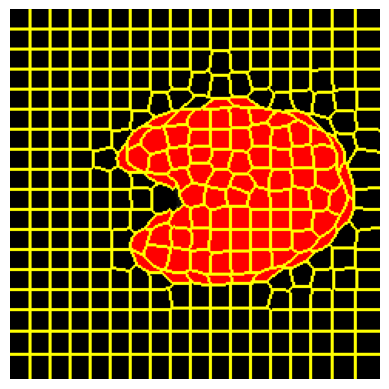

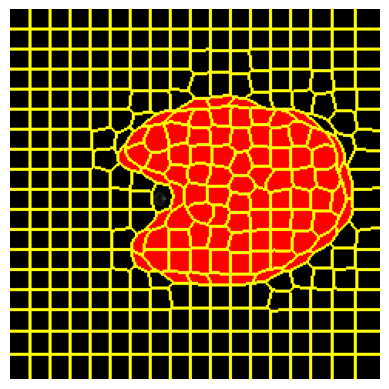

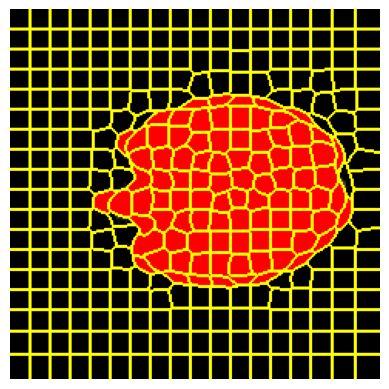

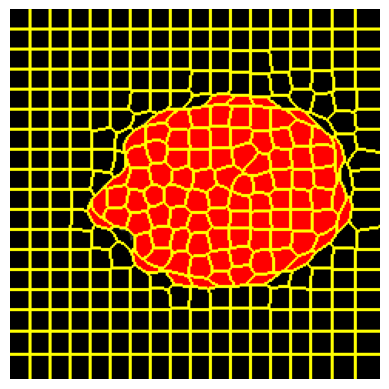

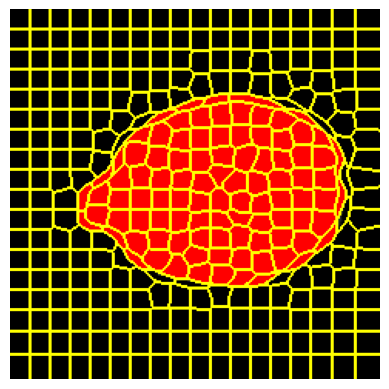

...

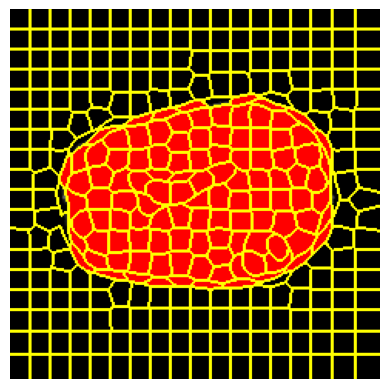

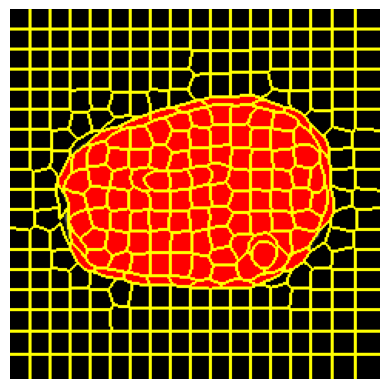

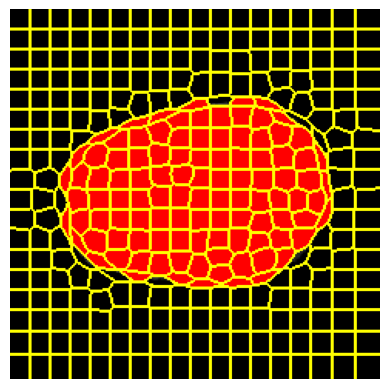

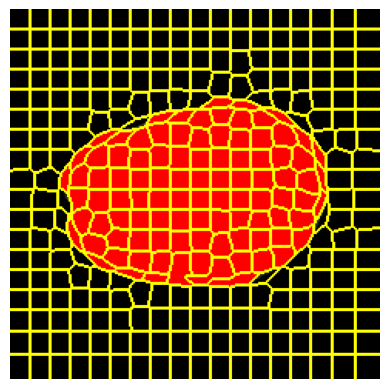

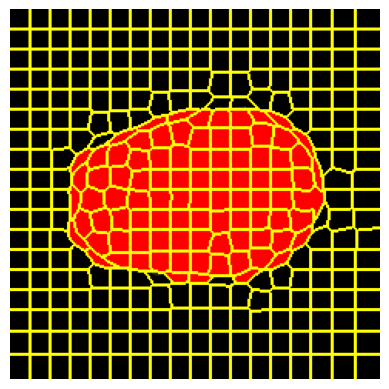

In [ ]:
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io
import matplotlib.pyplot as plt
train_sample = next(iter(train_dataloader))
x = train_sample['image'][tio.DATA]
y = train_sample['label'][tio.DATA]
color_img = np.stack([x[0].cpu().detach().numpy()] * 3, axis=-1)
shape=color_img.shape
for i in range(2):
    color_mask=np.zeros(shape)
    color_mask[0, :, :, :, i] = y[0, i].cpu().detach().numpy()
mixed = 1*color_img 
slices = np.stack(mixed[0, ..., range(40, 110, 5), :], axis=0)
numSegments = 350
graph=[]
for i, slice in enumerate(slices):
    segments = slic(slice, n_segments=numSegments, sigma=4)
    unique_segments = np.unique(segments)
    avg=average_color(slice, segments)
    segments_to_highlight = high(unique_segments,slice,segments,avg)
    l=[]
    graph.append(making_graph(slice, segments,segments_to_highlight,l))
    fig = plt.figure("Superpixels -- %d segments" % (numSegments))
    ax = fig.add_subplot(1, 1, 1)
    highlol=highlight_segments(slice, segments, segments_to_highlight)
    ax.imshow(mark_boundaries(highlol, segments))
    plt.axis("off")
    plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


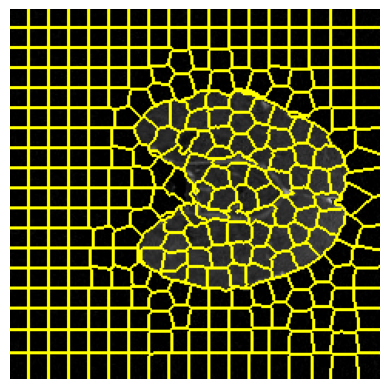

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


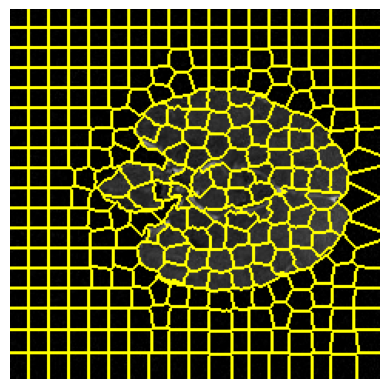

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


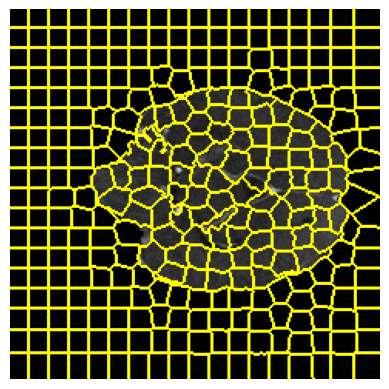

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


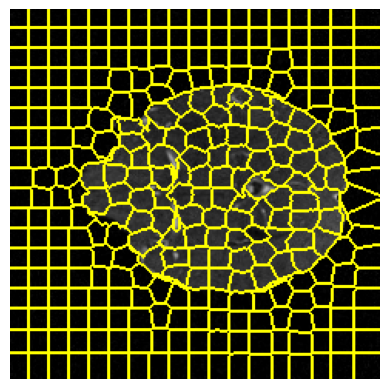

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


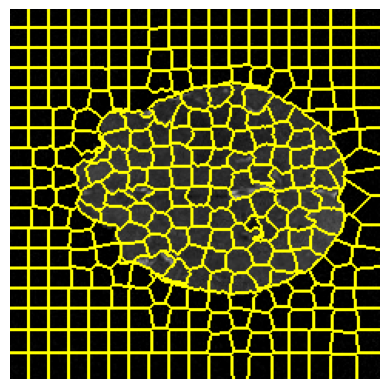

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


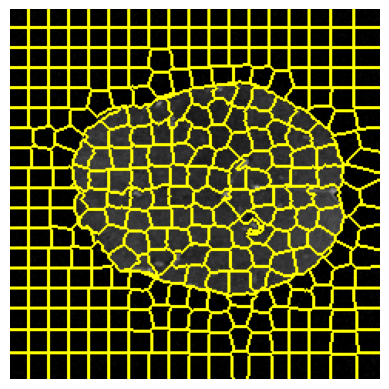

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


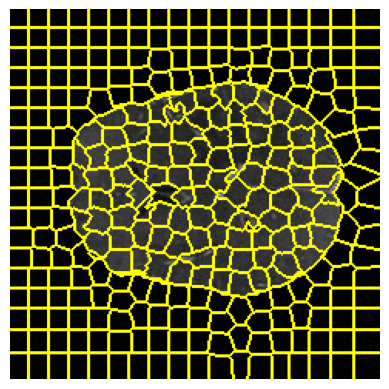

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


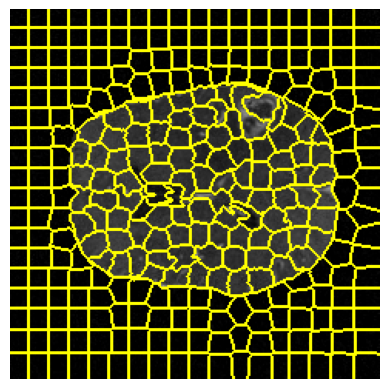

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


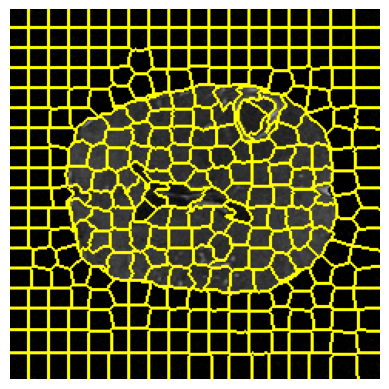

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


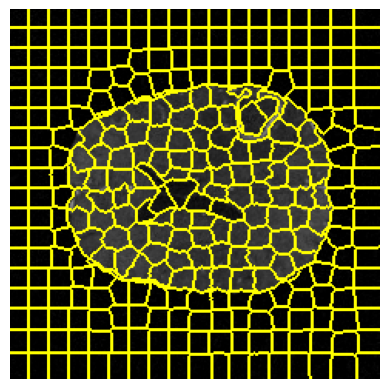

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


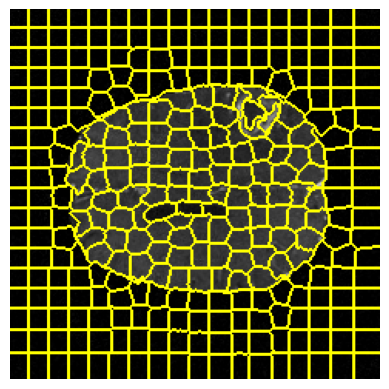

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


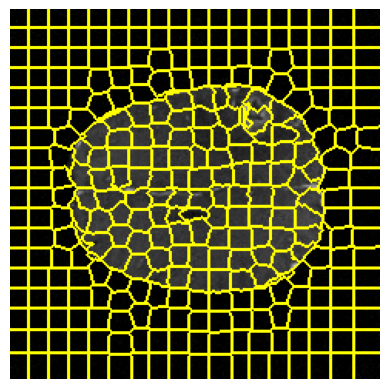

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


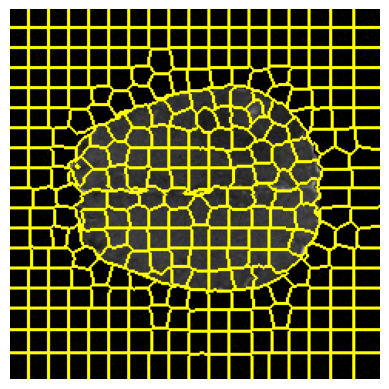

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


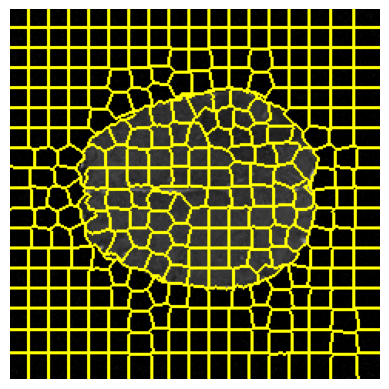

In [ ]:
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io
from skimage.morphology import dilation

import matplotlib.pyplot as plt
train_sample = next(iter(train_dataloader))
x = train_sample['image'][tio.DATA]
y = train_sample['label'][tio.DATA]
color_img = np.stack([x[0].cpu().detach().numpy()] * 3, axis=-1)
shape=color_img.shape
for i in range(2):
    color_mask=np.zeros(shape)
    color_mask[0, :, :, :, i] = y[0,1].cpu().detach().numpy()

mixed = color_img   
slices = np.stack(mixed[0, ..., range(40, 110, 5), :], axis=0)
numSegments = 350
for i, slice in enumerate(slices):
    segments = slic(slice, n_segments=numSegments, sigma=1)

    fig = plt.figure("Superpixels -- %d segments" % (numSegments))
    ax = fig.add_subplot(1, 1, 1)
    segments_dilated = dilation(segments)

    ax.imshow(mark_boundaries(slice, segments_dilated))
    plt.axis("off")
    plt.show()

torch.Size([1, 1, 240, 240, 155])
torch.Size([1, 2, 240, 240, 155])
(35, 240, 240, 3)
(2, 240, 35, 155)


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


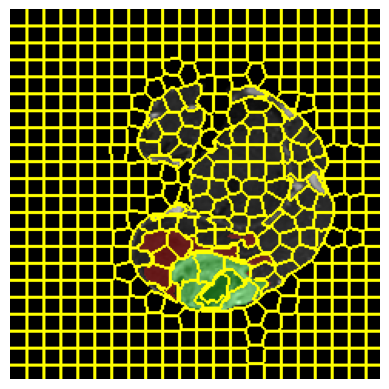

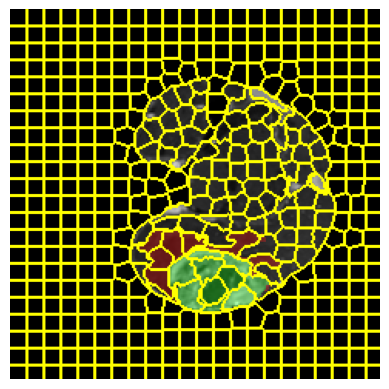

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


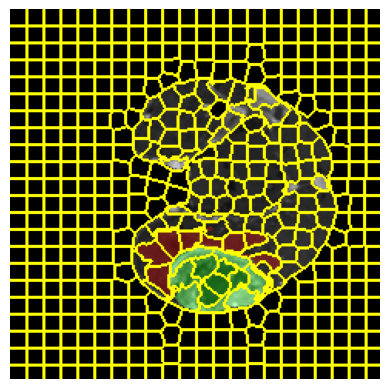

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


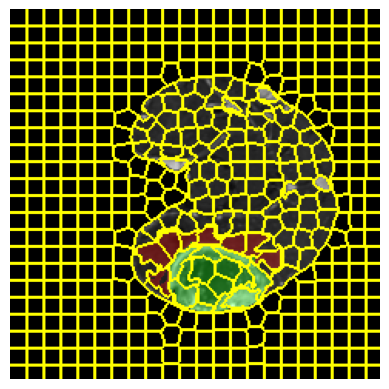

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


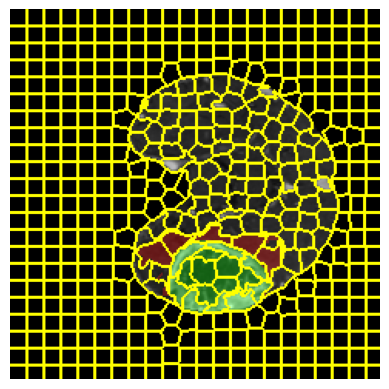

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


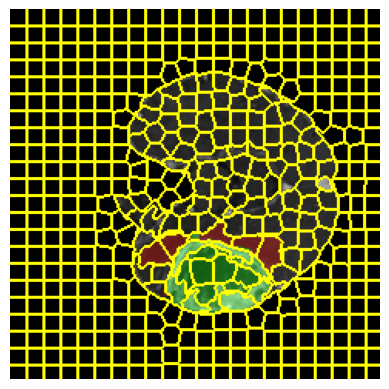

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


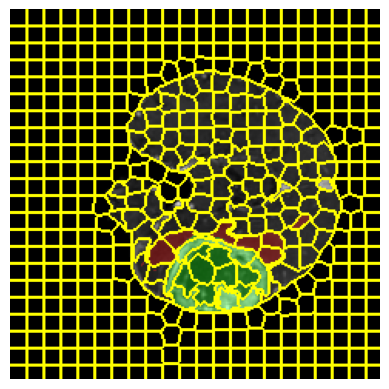

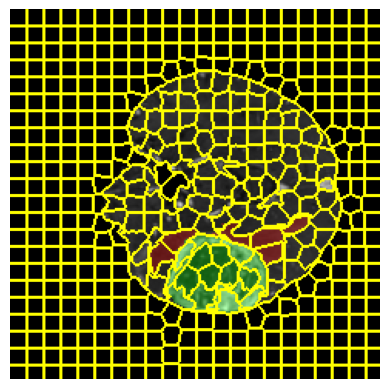

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


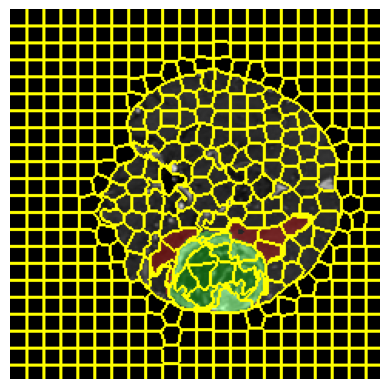

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


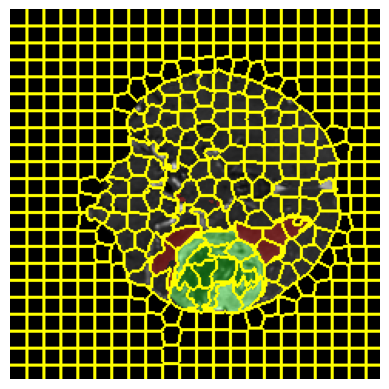

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


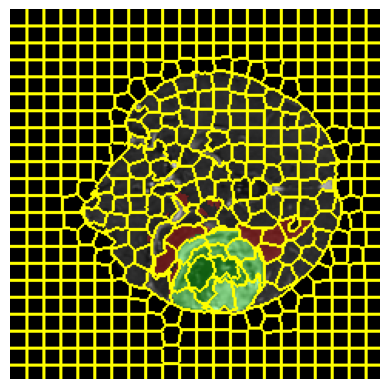

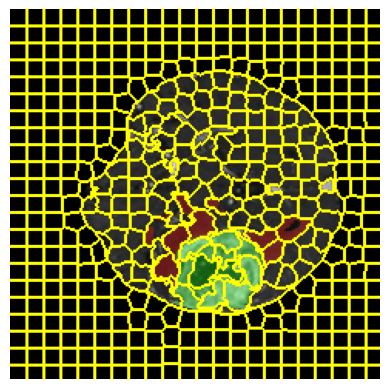

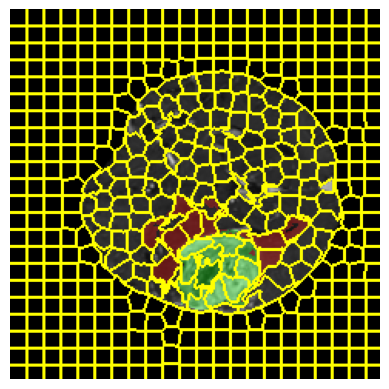

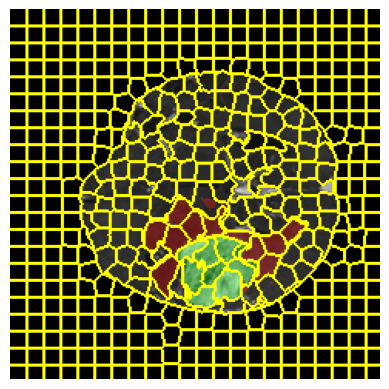

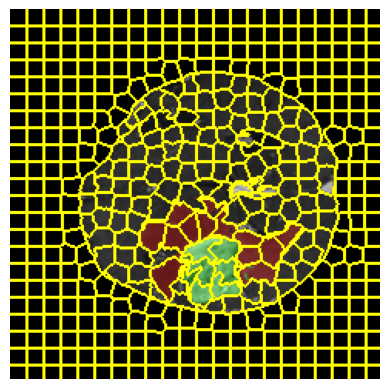

...

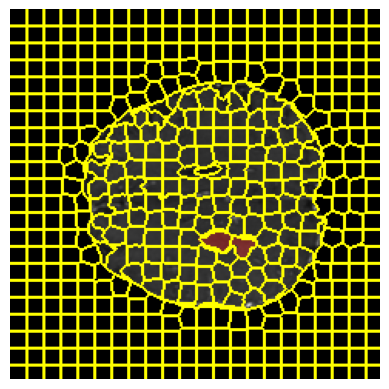

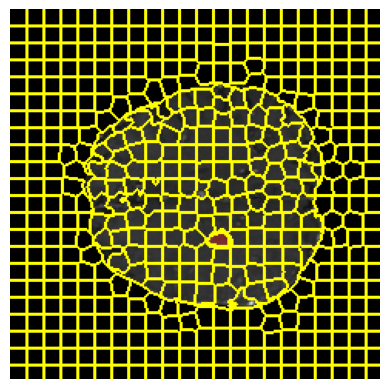

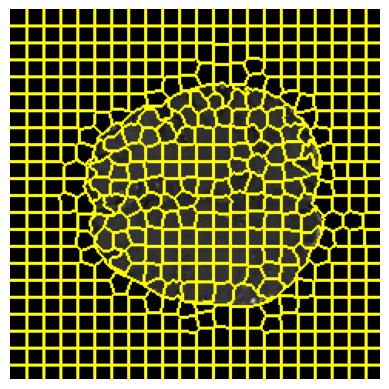

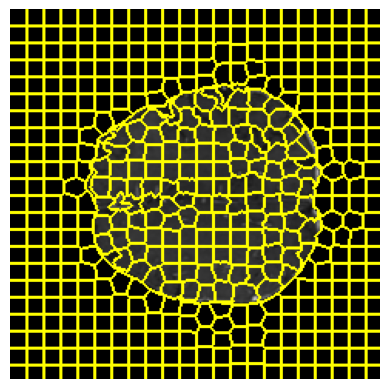

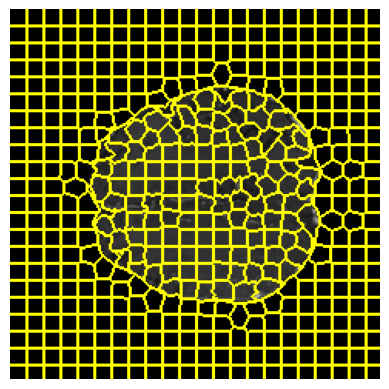

In [ ]:
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io
import matplotlib.pyplot as plt
# train_sample = next(iter(train_dataloader))
x = train_sample['image'][tio.DATA]
y = train_sample['label'][tio.DATA]
print(x.shape)
print(y.shape)
color_img = np.stack([x[0].cpu().detach().numpy()] * 3, axis=-1)
for i in range(2):
    color_mask[0, :, :, :, i] = y[0,i].cpu().detach().numpy()

mixed = color_img + 0.3*color_mask
slices = np.stack(mixed[0, ..., range(40, 110, 2), :], axis=0)
print(slices.shape)
print(np.stack(y[0, ..., range(40, 110, 2), :], axis=0).shape)
numSegments = 500
for i, slice in enumerate(slices):
    segments = slic(slice, n_segments=numSegments, sigma=1)

    fig = plt.figure("Superpixels -- %d segments" % (numSegments))
    ax = fig.add_subplot(1, 1, 1)
    ax.imshow(mark_boundaries(slice, segments))
    plt.axis("off")
    plt.show()

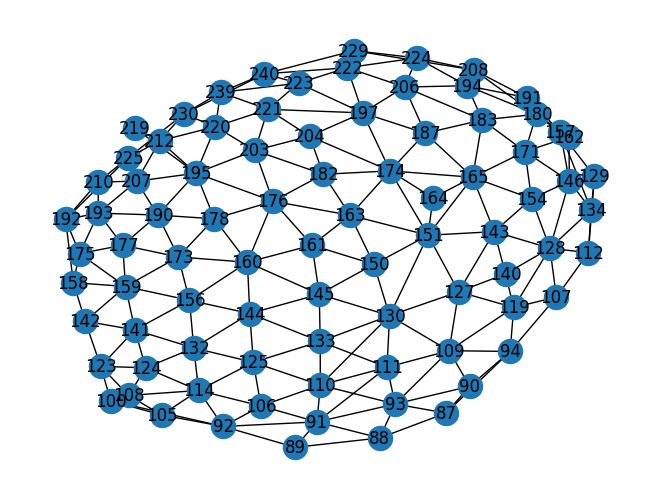

In [ ]:
import matplotlib.pyplot as plt

# Draw the graph
nx.draw(graph[7], with_labels=True)

# Show the plot
plt.show()

In [ ]:
train_sample = next(iter(train_dataloader))


In [11]:
def labeled_segments(segments, label_slice, overlap_threshold=0.5):
    overlapping_segments = []

    # Iterate over unique segment IDs
    for segment_id in np.unique(segments):
        # Create a mask for the current segment
        segment_mask = segments == segment_id

        # Calculate the overlap ratio
        # print(label_slice[segment_mask][1])
        
        overlap_ratio = np.sum(label_slice[segment_mask]) / np.sum(segment_mask)

        # Check if the overlap ratio is above the threshold
        if overlap_ratio > overlap_threshold:
            overlapping_segments.append(segment_id)

    return overlapping_segments

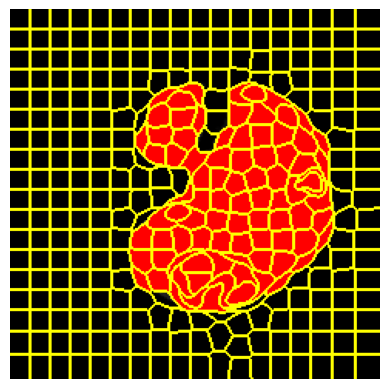

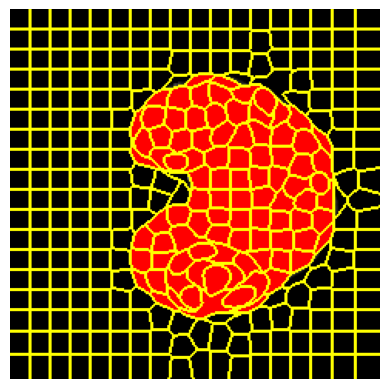

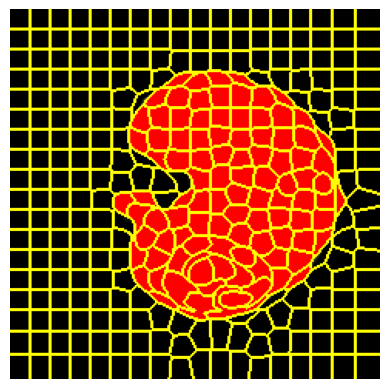

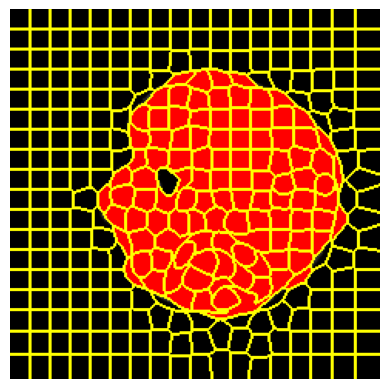

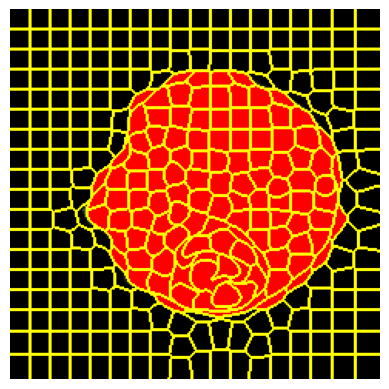

...

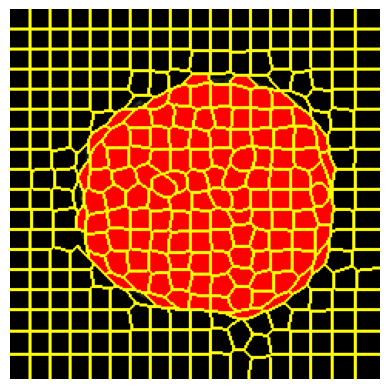

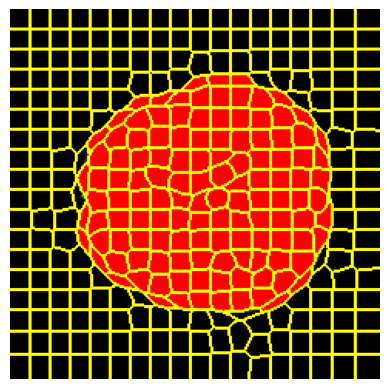

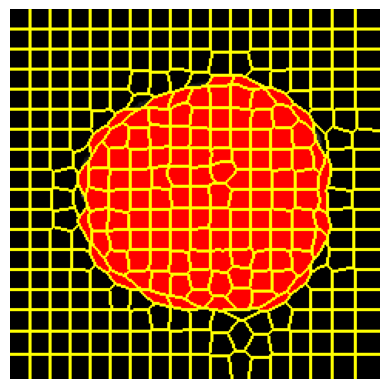

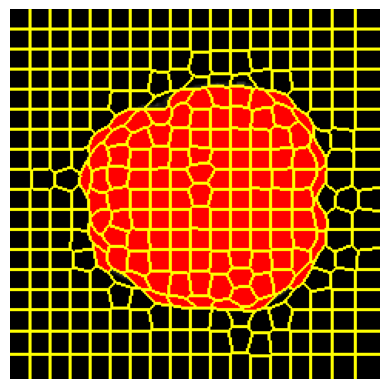

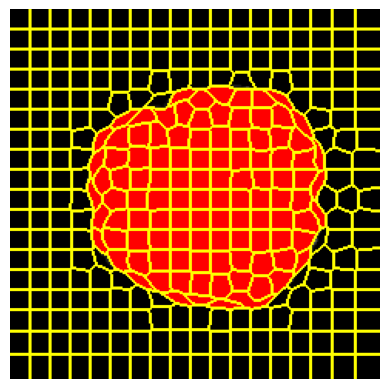

In [ ]:
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io
import matplotlib.pyplot as plt
# train_sample = next(iter(train_dataloader))
x = train_sample['image'][tio.DATA]
y = train_sample['label'][tio.DATA]
color_img = np.stack([x[0].cpu().detach().numpy()] * 3, axis=-1)
shape=color_img.shape
for i in range(2):
    color_mask=np.zeros(shape)
    color_mask[0, :, :, :, i] = y[0, i].cpu().detach().numpy()
mixed = 1*color_img 
slices = np.stack(mixed[0, ..., range(40, 110, 5), :], axis=0)
numSegments = 350
graph=[]
for i, slice in enumerate(slices):
    segments = slic(slice, n_segments=numSegments, sigma=4)
    unique_segments = np.unique(segments)
    avg=average_color(slice, segments)
    segments_to_highlight = high(unique_segments,slice,segments,avg)
    l=[]
    graph.append(making_graph(slice, segments,segments_to_highlight,l))
    fig = plt.figure("Superpixels -- %d segments" % (numSegments))
    ax = fig.add_subplot(1, 1, 1)
    highlol=highlight_segments(slice, segments, segments_to_highlight)
    ax.imshow(mark_boundaries(highlol, segments))
    plt.axis("off")
    plt.show()

In [20]:
graph=[]


torch.Size([2, 240, 240, 14])
(2, 240, 240, 14)
(14, 240, 240, 1)


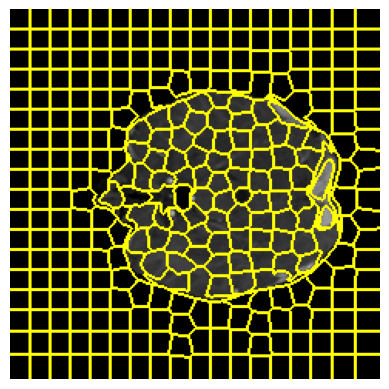

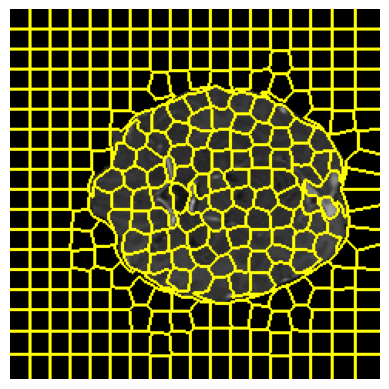

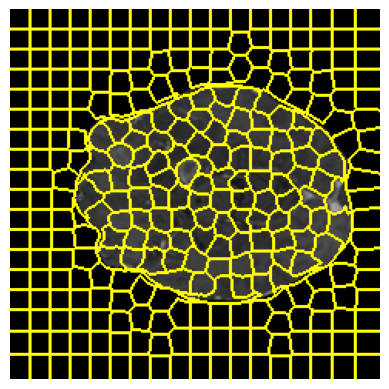

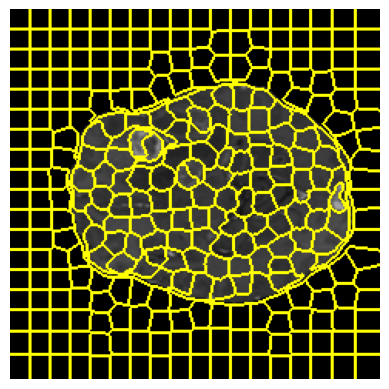

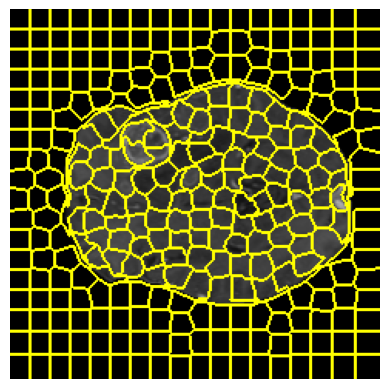

...

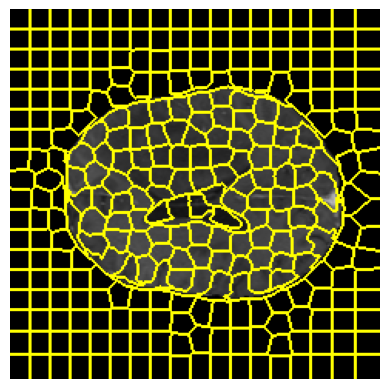

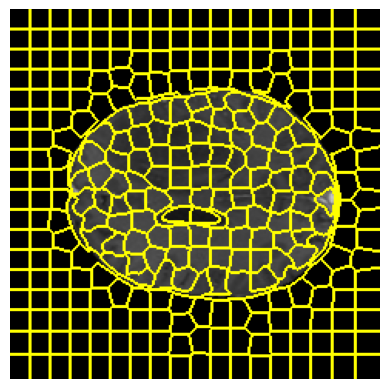

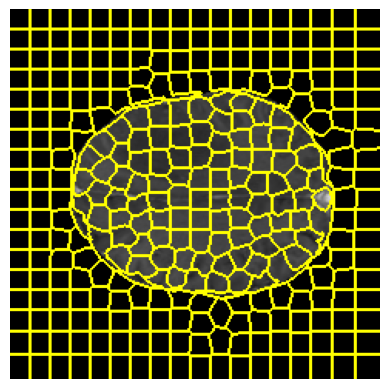

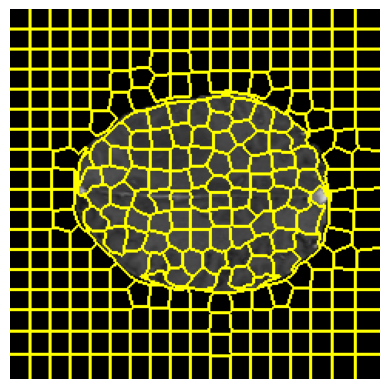

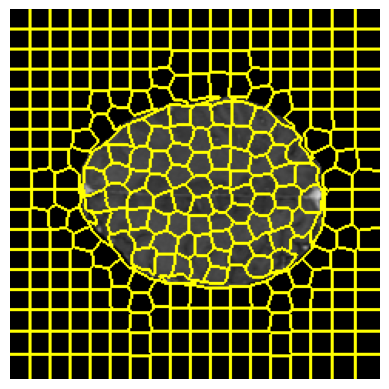

In [26]:
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io
import matplotlib.pyplot as plt
x = train_sample['image'][tio.DATA]

y = train_sample['label'][tio.DATA]

color_img = np.stack([x[0].cpu().detach().numpy()] * 3, axis=-1)
for i in range(2):
    color_mask[0, :, :, :, i] = y[0,i].cpu().detach().numpy()
mixed = color_img 
slices = np.stack(mixed[0, ..., range(40, 110, 5), :], axis=0)
slices.shape
numSegments = 350
print(y[0, ..., range(40, 110, 5)].shape)
label_slices = np.stack(y[0, ..., range(40, 110, 5)], axis=0)
print(label_slices.shape)
label_slices = np.transpose(label_slices, (3, 1, 2, 0))
label_slices = label_slices[..., 1:2]
print(label_slices.shape)

for i, (slice, label_slice) in enumerate(zip(slices, label_slices)):
    
    segments = slic(slice, n_segments=numSegments, sigma=2)

    

    labled_stuff=labeled_segments(segments,label_slice,0.4)
    slice2=highlight_segments(slice, segments, labled_stuff)

    unique_segments = np.unique(segments)
    avg=average_color(slice, segments)  
    
    segments_to_highlight = high(unique_segments,slice,segments,avg)

    graph.append(making_graph(slice, segments,segments_to_highlight,labled_stuff))


    fig = plt.figure("Superpixels -- %d segments" % (numSegments))
    ax = fig.add_subplot(1, 1, 1)
    ax.imshow(mark_boundaries(slice, segments))
    plt.axis("off")
    plt.show()

In [234]:
len(graph)

3904

In [230]:
for i in main_data[2000].nodes(data=True):
    print(i)

(14, {'area': 246, 'intensity': 0.00070324336, 'label': 0})
(15, {'area': 326, 'intensity': -0.08080581, 'label': 0})
(16, {'area': 217, 'intensity': 0.0031179946, 'label': 0})
(17, {'area': 206, 'intensity': -0.029715078, 'label': 0})
(18, {'area': 195, 'intensity': 0.0027656832, 'label': 0})
(19, {'area': 190, 'intensity': 0.002413247, 'label': 0})
(20, {'area': 185, 'intensity': -0.02443348, 'label': 0})
(21, {'area': 192, 'intensity': -0.013008117, 'label': 0})
(22, {'area': 204, 'intensity': 0.039319944, 'label': 0})
(24, {'area': 220, 'intensity': 0.013077555, 'label': 0})
(25, {'area': 109, 'intensity': 0.017332768, 'label': 0})
(26, {'area': 171, 'intensity': 0.0173552, 'label': 0})
(27, {'area': 187, 'intensity': -0.00062962616, 'label': 0})
(28, {'area': 204, 'intensity': -0.0052395617, 'label': 0})
(29, {'area': 212, 'intensity': -0.013944701, 'label': 0})
(30, {'area': 195, 'intensity': -0.014160688, 'label': 0})
(32, {'area': 233, 'intensity': 0.025151027, 'label': 0})
(33

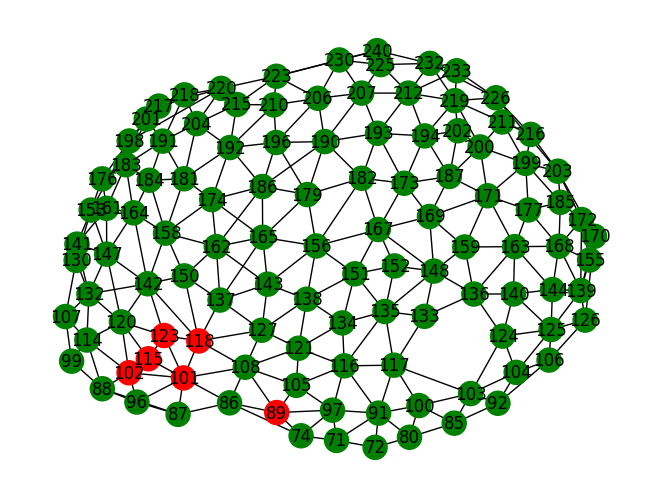

In [24]:
import matplotlib.pyplot as plt
import networkx as nx

# Assuming G is your graph
colors = ['red' if graph[5].nodes[n].get('label') == 1 else 'green' for n in graph[5].nodes]
nx.draw(graph[5], node_color=colors, with_labels=True)
plt.show()

In [ ]:
G = graph[7]

# Iterate over all edges and print their weights (contact lengths)
for (u, v, attr) in G.edges(data=True):
    contact_length = attr['weight']
    print(f"Contact length between segment {u} and segment {v}: {contact_length}")

Contact length between segment 68 and segment 69: 50
Contact length between segment 68 and segment 70: 52
Contact length between segment 68 and segment 72: 28
Contact length between segment 68 and segment 75: 16
Contact length between segment 68 and segment 77: 86
Contact length between segment 69 and segment 72: 80
Contact length between segment 69 and segment 73: 56
Contact length between segment 70 and segment 71: 36
Contact length between segment 70 and segment 75: 76
Contact length between segment 71 and segment 74: 104
Contact length between segment 71 and segment 75: 70
Contact length between segment 71 and segment 93: 66
Contact length between segment 72 and segment 77: 56
Contact length between segment 72 and segment 73: 58
Contact length between segment 72 and segment 90: 74
Contact length between segment 73 and segment 84: 60
Contact length between segment 73 and segment 91: 26
Contact length between segment 73 and segment 90: 6
Contact length between segment 73 and segment 

In [17]:
def normalizing(graphs):
    for G in graphs:
        max_area = max([G.nodes[n]['area'] for n in G.nodes])
        max_intensity = max([G.nodes[n]['intensity'] for n in G.nodes])
        min_intensity = min([G.nodes[n]['intensity'] for n in G.nodes])
        min_area= min([G.nodes[n]['area'] for n in G.nodes])

        for n in G.nodes:
            G.nodes[n]['area'] /= (max_area-min_area)
            G.nodes[n]['intensity'] /= (max_intensity-min_intensity)

In [ ]:
for i in graph:
    for j in i.nodes(data=True):
        print(j)

(73, {'area': 129, 'intensity': 0.12556782, 'label': 0})
(74, {'area': 201, 'intensity': 0.24523994, 'label': 0})
(75, {'area': 139, 'intensity': 0.15648346, 'label': 0})
(77, {'area': 278, 'intensity': 0.18138397, 'label': 0})
(88, {'area': 248, 'intensity': 0.07261797, 'label': 0})
(90, {'area': 177, 'intensity': 0.18044606, 'label': 0})
(91, {'area': 115, 'intensity': 0.24192691, 'label': 0})
(92, {'area': 194, 'intensity': 0.15642326, 'label': 0})
(93, {'area': 155, 'intensity': 0.14449608, 'label': 0})
(94, {'area': 117, 'intensity': 0.16343662, 'label': 0})
(106, {'area': 183, 'intensity': 0.14814775, 'label': 0})
(107, {'area': 205, 'intensity': 0.16655424, 'label': 0})
(108, {'area': 138, 'intensity': 0.13865347, 'label': 0})
(109, {'area': 200, 'intensity': 0.14535378, 'label': 0})
(110, {'area': 211, 'intensity': 0.14679267, 'label': 0})
(112, {'area': 188, 'intensity': 0.15504271, 'label': 0})
(114, {'area': 126, 'intensity': 0.12624387, 'label': 0})
(122, {'area': 182, 'int

In [ ]:
normalizing(graph)

In [ ]:
for i in graph:
    for j in i.nodes(data=True):
        print(j)

(73, {'area': 0.6262135922330098, 'intensity': 0.31874302, 'label': 0})
(74, {'area': 0.9757281553398058, 'intensity': 0.6225203, 'label': 0})
(75, {'area': 0.6747572815533981, 'intensity': 0.3972197, 'label': 0})
(77, {'area': 1.3495145631067962, 'intensity': 0.46042746, 'label': 0})
(88, {'area': 1.203883495145631, 'intensity': 0.18433441, 'label': 0})
(90, {'area': 0.8592233009708737, 'intensity': 0.45804667, 'label': 0})
(91, {'area': 0.558252427184466, 'intensity': 0.61411047, 'label': 0})
(92, {'area': 0.941747572815534, 'intensity': 0.39706686, 'label': 0})
(93, {'area': 0.7524271844660194, 'intensity': 0.36679077, 'label': 0})
(94, {'area': 0.5679611650485437, 'intensity': 0.4148697, 'label': 0})
(106, {'area': 0.8883495145631068, 'intensity': 0.37606022, 'label': 0})
(107, {'area': 0.9951456310679612, 'intensity': 0.4227835, 'label': 0})
(108, {'area': 0.6699029126213593, 'intensity': 0.35195982, 'label': 0})
(109, {'area': 0.970873786407767, 'intensity': 0.36896795, 'label': 

In [19]:
graph=[]


In [118]:
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io
import matplotlib.pyplot as plt
for j in range(200):
    print(j)
    train_sample = next(iter(train_dataloader))

    x = train_sample['image'][tio.DATA]

    y = train_sample['label'][tio.DATA]

    color_img = np.stack([x[0].cpu().detach().numpy()] * 3, axis=-1)
    for i in range(2):
        color_mask[0, :, :, :, i] = y[0,i].cpu().detach().numpy()

    mixed = color_img 
    slices = np.stack(mixed[0, ..., range(40, 110, 5), :], axis=0)
    slices.shape
    numSegments = 350
    label_slices = np.stack(y[0, ..., range(40, 110, 5)], axis=0)

    label_slices = np.transpose(label_slices, (3, 1, 2, 0))
    label_slices = label_slices[..., 1:2]


    for i, (slice, label_slice) in enumerate(zip(slices, label_slices)):
        
        segments = slic(slice, n_segments=numSegments, sigma=2)

        

        labled_stuff=labeled_segments(segments,label_slice,0.6)
        slice2=highlight_segments(slice, segments, labled_stuff)

        unique_segments = np.unique(segments)
        avg=average_color(slice, segments)  
        
        segments_to_highlight = high(unique_segments,slice,segments,avg)

        graph.append(making_graph(slice, segments,segments_to_highlight,labled_stuff))

        # fig = plt.figure("Superpixels -- %d segments" % (numSegments))
        # ax = fig.add_subplot(1, 1, 1)
        # ax.imshow(mark_boundaries(slice2, segments))
        # plt.axis("off")
        # plt.show()

0
1
2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41
42
43
44
45
46
47
48
49
50
51
52
53
54
55
56
57
58
59
60
61
62
63
64
65
66
67
68
69
70
71
72
73
74
75
76
77
78
79
80
81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99
100
101
102
103
104
105
106
107
108
109
110
111
112
113
114
115
116
117
118
119
120
121
122
123
124
125
126
127
128
129
130
131
132
133
134
135
136
137
138
139
140
141
142
143
144
145
146
147
148
149
150
151
152
153
154
155
156
157
158
159
160
161
162
163
164
165
166
167
168
169
170
171
172
173
174
175
176
177
178
179
180
181
182
183
184
185
186
187
188
189
190
191
192
193
194
195
196
197
198
199


In [119]:
# main_data=graph[:]

In [148]:
graph=main_data[:]

In [149]:
flag_graphs=[]

In [150]:
for i in graph:
    for j in i.nodes(data=True):
        if j[1]['label']==1:
            print(j[1]['label'])
            flag_graphs.append(i)
            continue


1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1
1


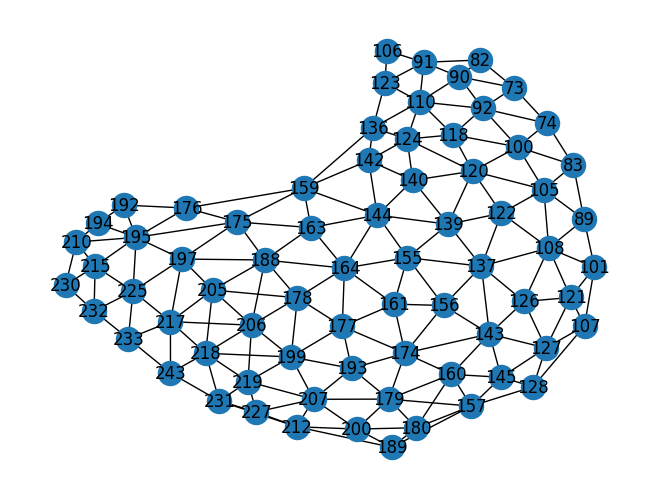

In [109]:
nx.draw(graph[0], with_labels=True)

In [121]:
normalizing(graph)

normalizing(graph)

In [151]:
len(graph),len(main_data),len(flag_graphs)


(3862, 3862, 1508)

this was preprocessing

now model time

# Models


In [23]:
import networkx as nx
from node2vec import Node2Vec

In [1099]:
node2vec = Node2Vec(graph[20], dimensions=64, walk_length=6, num_walks=100, workers=4, p=1, q=0.5)

Computing transition probabilities: 100%|██████████| 69/69 [00:00<00:00, 8626.65it/s]


In [1100]:
model = node2vec.fit(window=1, min_count=1, batch_words=4)

In [548]:
combined_features = np.concatenate([node2vec_embeddings, node_features], axis=1)

NameError: name 'node2vec_embeddings' is not defined

In [1101]:
vector_for_node_1 = model.wv['187']  

In [1091]:
model.wv.most_similar('187')

[('178', 0.958379328250885),
 ('200', 0.9275448322296143),
 ('174', 0.9128350615501404),
 ('197', 0.90846186876297),
 ('172', 0.904475748538971),
 ('194', 0.9023997783660889),
 ('203', 0.8552091717720032),
 ('185', 0.842676043510437),
 ('204', 0.8349581956863403),
 ('165', 0.8334410786628723)]

In [551]:
vector_for_node_1

array([-0.03549407,  0.20300789,  0.46807888, -0.3252724 , -0.22934274,
       -0.9915665 ,  0.4230527 ,  0.04789045, -0.1741365 , -0.48434198,
        0.31160018,  0.13425632, -0.20404896, -0.27498633, -0.7243765 ,
        0.15287355,  0.44455263,  0.18157749, -0.3044341 ,  0.34222826,
       -0.00284613,  0.7942049 ,  0.87527645, -0.53247154, -0.00933883,
        0.65191334, -1.1208245 , -0.06483516,  0.07621558, -0.6895164 ,
       -0.05441754,  0.07916081, -0.23539545,  0.13713357, -0.37336978,
       -0.43729398,  0.19296838,  0.10610412,  0.6677142 , -0.22741002,
       -0.18752156, -0.00575514,  0.07734682,  0.0909616 ,  0.19752315,
       -0.08226968, -0.07622131, -0.00776149,  0.44154808,  0.53355557,
       -0.28741798,  0.3137874 , -0.65564364,  0.24308768, -0.05967786,
        0.6388373 ,  0.32691053, -0.5206323 ,  0.09897008,  0.19424811,
        0.27586275, -0.2501162 , -0.5303892 , -0.12616158], dtype=float32)

In [1102]:
vector_for_node_1 = model.wv.most_similar('169')

In [1103]:
vector_for_node_1


[('184', 0.9549826383590698),
 ('171', 0.926703929901123),
 ('154', 0.9171538352966309),
 ('151', 0.9108104705810547),
 ('200', 0.9033946394920349),
 ('197', 0.8751672506332397),
 ('153', 0.8436823487281799),
 ('179', 0.814075231552124),
 ('201', 0.802118182182312),
 ('165', 0.7876071333885193)]

In [561]:
model.wv.most_similar('204')

[('208', 0.9830912947654724),
 ('187', 0.9195776581764221),
 ('217', 0.8978875279426575),
 ('167', 0.8923597931861877),
 ('192', 0.8885724544525146),
 ('180', 0.8652193546295166),
 ('214', 0.8590211868286133),
 ('203', 0.8548240065574646),
 ('229', 0.8326855897903442),
 ('156', 0.808546781539917)]

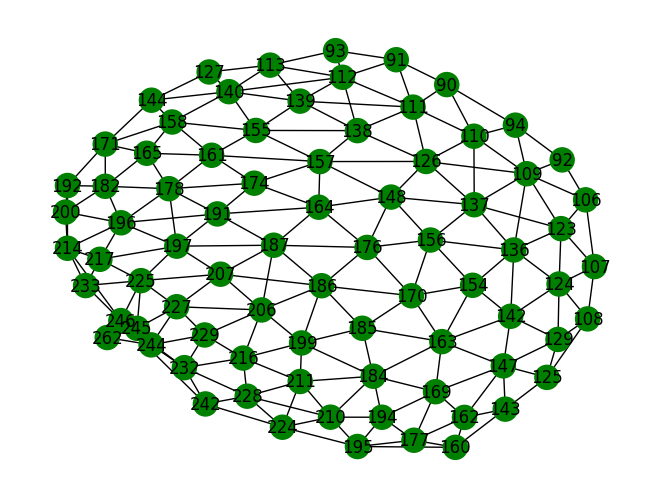

In [154]:
import matplotlib.pyplot as plt
import networkx as nx
ll=20

# Assuming G is your graph
colors = ['red' if graph[ll].nodes[n].get('label') == 1 else 'green' for n in graph[ll].nodes]
nx.draw(graph[ll], node_color=colors,with_labels=True)
plt.show()

In [ ]:
# Assuming `model` is your trained model, and `node_ids` is a list of all node IDs
embeddings = np.array([model.wv[str(node_id)] for node_id in node_ids])
labels = np.array([label_of_node[node_id] for node_id in node_ids])  # Assuming you have a way to get the label for each node

In [570]:
for i in graph:
    for j in i.nodes():
        print(j)


71
72
83
85
86
87
88
89
91
97
98
100
103
104
105
107
108
109
116
117
118
120
121
123
124
130
132
133
134
135
138
140
141
147
149
150
151
154
157
158
165
166
167
169
170
172
180
181
182
183
185
186
187
190
191
197
198
199
200
203
204
206
207
213
215
216
219
222
229
231
70
80
81
84
85
86
87
88
95
96
97
99
101
102
103
104
106
107
113
114
115
116
119
120
121
124
129
130
132
133
134
136
139
140
142
147
148
149
151
153
154
157
165
166
167
168
169
170
173
180
181
183
184
186
187
189
195
196
197
198
202
203
205
210
212
213
214
217
226
227
81
82
83
85
86
87
88
89
90
97
101
102
103
104
106
107
108
109
115
118
119
120
121
122
129
130
132
133
134
136
137
140
141
142
143
149
150
151
155
156
164
165
166
167
168
169
170
172
180
181
183
184
185
186
187
189
196
197
198
199
201
204
205
206
213
214
215
218
227
228
232
235
71
82
83
85
86
87
88
90
91
92
100
102
103
104
105
107
113
114
115
117
119
120
121
122
123
125
126
133
134
135
136
137
138
140
141
142
149
150
151
154
155
157
160
166
167
168
169
170
173

In [33]:
main_data=graph[30:530]

In [34]:
for i in graph:
    node2vec = Node2Vec(i, dimensions=64, walk_length=6, num_walks=100, workers=4, p=1, q=0.5)
    model = node2vec.fit(window=4, min_count=1, batch_words=4)
    for j in i.nodes(): 
        try:
            print(model.wv[j])
        except:
            pass

Computing transition probabilities: 100%|██████████| 87/87 [00:00<00:00, 9667.11it/s]


[ 0.22281048 -0.10076409  0.05240002 -0.16959733  0.15126042 -0.4841894
  0.1685203   0.20025936 -0.49736577 -0.8710982  -0.09758257 -0.44694534
 -0.8635671  -0.33964148  0.02260921  0.49549267  0.0763308   0.0745018
  0.61349165  0.46525633  0.43339822  0.60377645  0.21950938 -0.790057
  0.14144248 -0.1242927  -0.9271662  -0.39333892  0.31555337  0.19129281
  0.28824306  0.05102509 -0.3244584  -0.63718486  0.04861034 -0.00801936
  0.05904816  0.41048032  0.69461757  0.30286914  0.07168916 -0.18095908
  0.31303027 -0.26369718 -0.38726255 -0.1827034  -0.06053672 -0.6529663
 -0.31077665  0.25761852  0.12512557  0.6126725   0.3129701   0.25907636
  0.553491    0.7707979   0.35801923 -0.31949788  0.37502125 -0.05870591
  0.1929838  -0.5111076  -0.04801675 -0.20541893]
[ 0.03862875 -0.30219802  0.8086623  -0.20621708  0.01280142 -1.0050989
 -0.09320339 -0.7312948  -0.41206917 -0.6048854   0.62796736 -0.53774697
 -0.7028852  -0.37368062 -0.09394388 -0.32365432  0.4061939  -0.08405955
  0.325

Computing transition probabilities: 100%|██████████| 94/94 [00:00<00:00, 10438.56it/s]


[ 0.0649488   0.10377221  0.33841705 -0.08259553  0.25989553 -0.594942
  0.48786145 -0.44471425 -0.8528656  -0.6108473   0.2998143  -0.77222496
 -0.6432866  -0.35224518 -0.0727685  -0.339063   -0.13112167 -0.54487586
  0.33191928  0.05334103  0.48064938 -0.02511485  0.5683607  -0.7995712
 -0.07955267 -0.07100879 -0.44267306  0.03837366  0.21920784  0.05998379
  0.5413311   0.384356   -0.5515122  -0.54214334 -0.21335457 -0.38487038
  0.20852712  0.34641773  0.5941069   0.17568119  0.6903263  -0.17332381
 -0.7471345   0.10718527  0.27667493 -0.10318579  0.5562941  -0.62207186
  0.03047104  0.12775624 -0.22369397  0.47616175  0.3019227   0.516159
  0.35105807  0.6714743  -0.14508389 -0.12812841 -0.35087985  0.5891221
  0.21546435 -0.42976078  0.09618691  0.3956371 ]
[ 0.20398487 -0.02046436 -0.0791458  -0.17925347 -0.26413152 -0.3684943
  0.22668998 -0.27087265 -0.10477831  0.03653571  0.10332103 -0.4611827
 -0.4522479  -0.6895461   0.4243823   0.5452074   0.3863546  -0.20107451
 -0.00665

Computing transition probabilities: 100%|██████████| 99/99 [00:00<00:00, 8999.48it/s]


[ 0.82860714 -0.4520722   0.18893322 -0.37327084 -0.0721378   0.52235657
 -0.10703337 -0.04578773 -0.08469802 -0.35637686  0.28196877 -0.47680306
 -0.84090155  0.19253573 -0.20447062  0.8943969  -0.20462508 -0.7497254
 -0.4035505   0.31750768  0.09334403  0.21273512  0.3946529  -0.23431431
  0.4122903   0.38370442 -0.50720155 -0.67555106 -0.18002366  0.13898396
  0.11268189 -0.46183816 -0.1570311  -0.2756853  -0.41231707  0.11121773
 -0.12985466 -0.34374422 -0.07590295  0.21212953 -0.2040399  -0.44768095
 -0.09996247 -0.5667435   0.19311158 -0.673454    0.3413475  -0.4784
 -0.07825946 -0.15675724 -0.03495128 -0.25014508  0.12038748  0.7316418
  0.47814202 -0.25427794  0.41749874  0.4119012  -0.5114876   1.0536327
 -0.47002503 -0.5854084   0.010861    0.0295588 ]
[ 0.40711316 -0.24601823  0.1873964   0.43946633 -0.01184786 -0.51106334
  0.23629358  0.04579275 -0.9722758   0.2243363  -0.20371287 -0.83975583
  0.09444895 -0.47161356  0.29083976  0.4841039   0.36541754 -0.0521658
  0.20128

Computing transition probabilities: 100%|██████████| 109/109 [00:00<00:00, 9910.24it/s]


KeyboardInterrupt: 

In [27]:
len(graph)

2101

In [36]:
from node2vec import Node2Vec
import networkx as nx

# Example list of networkx graphs
graphs = graph[30:530]  

# Dictionary to hold embeddings
all_embeddings = {}

for i, g in enumerate(graphs):
    node2vec = Node2Vec(g, dimensions=64, walk_length=30, num_walks=200, workers=4)
    model = node2vec.fit(window=4, min_count=1, batch_words=4)
    embeddings = {node: model.wv[str(node)] for node in g.nodes()}
    all_embeddings[f"Graph_{i}"] = embeddings

Computing transition probabilities: 100%|██████████| 96/96 [00:00<00:00, 9320.46it/s]


KeyboardInterrupt: 

In [216]:
def process_graph(i, g):
    node2vec = Node2Vec(g, dimensions=64, walk_length=15, num_walks=100, workers=1)  # Set workers=1 for Node2Vec internal threading
    model = node2vec.fit(window=4, min_count=1, batch_words=4)
    
    # Generate embeddings and labels
    embeddings = {node: model.wv[str(node)] for node in g.nodes()}
    # labels = get_labels_for_graph(g)  # Get labels for nodes in the graph
    
    # Store embeddings and labels back to the graph as node attributes
    nx.set_node_attributes(g, embeddings, 'embedding')
    # nx.set_node_attributes(g, labels, 'label')
    
    return f"Graph_{i}", g  # Return the graph with embeddings and labels as attributes

In [217]:
from node2vec import Node2Vec
import networkx as nx
from concurrent.futures import ThreadPoolExecutor, as_completed
import numpy as np

In [228]:
with ThreadPoolExecutor(max_workers=20) as executor:  
    futures = [executor.submit(process_graph, i, g) for i, g in enumerate(graph)]
    
    for future in as_completed(futures):
        graph_id, graph_with_attrs = future.result()


Computing transition probabilities: 100%|██████████| 76/76 [00:00<00:00, 5843.36it/s]


Computing transition probabilities: 100%|██████████| 95/95 [00:00<00:00, 2638.35it/s]

Generating walks (CPU: 1):   0%|          | 0/100 [00:00<?, ?it/s]





















































Generating walks (CPU: 1):  32%|███▏      | 32/100 [00:00<00:00, 315.76it/s]










Computing transition probabilities: 100%|██████████| 100/100 [00:00<00:00, 278.82it/s]


























Generating walks (CPU: 1):  64%|██████▍   | 64/100 [00:00<00:00, 186.95it/s]




Computing transition probabilities: 100%|██████████| 90/90 [00:00<00:00, 227.80it/s]




Generating walks (CPU: 1):  86%|████████▌ | 86/100 [00:00<00:00, 186.13it/s]

Computing transition probabilities: 100%|██████████| 94/94 [00:00<00:00, 198.14it/s]




Computing transition probabilities: 100%|██████████| 84/84 [00:00<00:00, 222.13it/s]















Generating walks (CPU: 1): 100%|██████████| 100/100 [00:01<00:00, 71.59it/s]








Generating walks (CPU: 1):   0%|          | 0/100 [00:00<?, ?it/s]





In [232]:
graph_id

'Graph_1396'

In [233]:
for i in graph:
    for j in i.nodes(data=True):
        print(j)

(71, {'area': 1.0059171597633136, 'intensity': 0.34372497, 'label': 0, 'embedding': array([ 0.42955437, -0.23296405,  0.73614055,  0.09129094, -0.04408238,
       -0.34126028,  0.0578285 , -0.24062224,  0.3441326 , -0.13096957,
        0.36409307, -0.58148706, -0.26013517, -0.54501057, -0.16970733,
       -0.01286338,  0.5391708 ,  0.19084603, -0.20249234,  0.05113433,
        0.75571704,  0.83844167, -0.02815521, -0.13765766, -0.36291555,
        0.7801224 , -0.8461253 , -0.02859875, -0.00717969,  0.11079289,
        0.17415136, -0.03677809, -0.14647694, -0.29355556, -0.27247262,
        0.00722193,  0.2606824 , -0.40154034,  0.356591  ,  0.48963797,
       -0.01494446,  0.12432176, -0.15965582, -0.22234087, -0.1815407 ,
       -0.30024505,  0.1355472 , -0.3020751 , -0.5818963 , -0.53013736,
        0.2605771 , -0.16897382,  0.11905676,  0.8620456 ,  0.31674626,
        0.3327189 , -0.026216  , -0.19191436, -0.8319423 ,  0.3110949 ,
        0.20696652, -0.34323698, -0.2182894 ,  0.293

KeyboardInterrupt: 

In [231]:
for i in graph_id:
    print(i)

G
r
a
p
h
_
1
3
9
6


In [28]:
len(graph)

2101

In [26]:
# from node2vec import Node2Vec
# import networkx as nx
# from concurrent.futures import ThreadPoolExecutor, as_completed
# import numpy as np

# graphs = graph[30:530]  # Assuming 'graph' is defined elsewhere
# def process_graph(i, g):
#     node2vec = Node2Vec(g, dimensions=64, walk_length=15, num_walks=100, workers=1)  # Set workers=1 for Node2Vec internal threading
#     model = node2vec.fit(window=4, min_count=1, batch_words=4)
#     embeddings = {node: model.wv[str(node)] for node in g.nodes()}
#     # labels = get_labels_for_graph(g)  # Get labels for nodes in the graph
#     return f"Graph_{i}", embeddings, labels

# all_embeddings_and_labels = {}

# with ThreadPoolExecutor(max_workers=20) as executor:  # Adjust max_workers as needed
#     futures = [executor.submit(process_graph, i, g) for i, g in enumerate(graphs)]
    
#     for future in as_completed(futures):
#         graph_id, embeddings, labels = future.result()
#         all_embeddings_and_labels[graph_id] = {'embeddings': embeddings, 'labels': labels}



Computing transition probabilities: 100%|██████████| 90/90 [00:00<00:00, 1405.67it/s]














Computing transition probabilities:   0%|          | 0/99 [00:00<?, ?it/s]







































Computing transition probabilities: 100%|██████████| 85/85 [00:00<00:00, 322.18it/s]












Computing transition probabilities: 100%|██████████| 72/72 [00:00<00:00, 280.87it/s]







Computing transition probabilities: 100%|██████████| 89/89 [00:00<00:00, 269.54it/s]

















Computing transition probabilities: 100%|██████████| 96/96 [00:00<00:00, 301.04it/s]













Computing transition probabilities: 100%|██████████| 68/68 [00:00<00:00, 231.39it/s]







Computing transition probabilities: 100%|██████████| 79/79 [00:00<00:00, 170.11it/s]













Computing transition probabilities: 100%|██████████| 72/72 [00:00<00:00, 134.18it/s]







Computing transition probabilities: 100%|██████████| 56/56 [00:00<00:00, 99.45it/s]














Generating walks 

In [1148]:
import torch
from torch_geometric.nn import GCNConv
from torch_geometric.data import DataLoader

class GNN(torch.nn.Module):
    def __init__(self):
        super(GNN, self).__init__()
        self.conv1 = GCNConv(dataset.num_node_features, 16)
        self.conv2 = GCNConv(16, dataset.num_classes)

    def forward(self, data):
        x, edge_index = data.x, data.edge_index
        x = torch.relu(self.conv1(x, edge_index))
        x = self.conv2(x, edge_index)
        return x

model = GNN()
loader = DataLoader(graphs, batch_size=1, shuffle=False)

all_embeddings = {}

for i, data in enumerate(loader):
    embeddings = model(data).detach().numpy()  # Assuming the model outputs embeddings directly
    all_embeddings[f"Graph_{i}"] = {node: embeddings[node] for node in range(data.num_nodes)}

AttributeError: 'SubjectsDataset' object has no attribute 'num_node_features'

In [227]:
def get_labels_for_graph(g):
    # Example logic: Assign labels based on some property of the node or graph
    labels = {}
    for node in g.nodes(data=True):
        # Assume each node has an attribute 'type' which determines its label
        # This is just an example; replace it with your actual logic
        node_label = node[1].get('label')  # Default label is 0 if 'type' attribute is missing
        labels[node[0]] = node_label
    return labels

In [226]:
for ii in graph[0].nodes(data=True):
    print(ii[1].get("label"))


0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
0
0
0
1
0
0
0


In [38]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch_geometric.nn import GATConv

class GAT(nn.Module):
    def __init__(self, in_channels, out_channels, heads):
        super(GAT, self).__init__()
        self.conv1 = GATConv(in_channels, out_channels, heads=heads)
        self.conv2 = GATConv(out_channels*heads, 2, heads=1)

    def forward(self, x, edge_index):
        x = F.dropout(x, p=0.1, training=self.training)
        x = F.elu(self.conv1(x, edge_index))
        x = F.dropout(x, p=0.6, training=self.training)
        x = self.conv2(x, edge_index)
        return F.log_softmax(x, dim=1)
     


In [370]:
import torch
import torch.nn.functional as F
from torch_geometric.nn import GCNConv
# Define GCN model
class GCN(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super(GCN, self).__init__()
        self.conv1 = GCNConv(in_channels, hidden_channels)
        self.conv2 = GCNConv(hidden_channels, hidden_channels)
        self.conv3 = GCNConv(hidden_channels, hidden_channels)
        self.conv4 = GCNConv(hidden_channels, out_channels)
        
    def forward(self, x, edge_index):
        x = F.dropout(x, training=self.training)
        x = F.relu(self.conv1(x, edge_index))
        x = F.dropout(x, training=self.training)
        x = F.relu(self.conv2(x, edge_index))
        x = F.dropout(x, training=self.training)
        x = F.relu(self.conv3(x, edge_index))
        x = F.dropout(x, training=self.training)
        x = self.conv4(x, edge_index)
        return F.log_softmax(x, dim=1)

In [210]:
model = GAT(2,32,5)
# Define the optimizer and loss function
optimizer = torch.optim.Adam(model.parameters(), lr=0.0050)
criterion = torch.nn.CrossEntropyLoss()

In [418]:
model = GCN(66, 32, 2)
optimizer = torch.optim.Adam(model.parameters(), lr=0.1)

In [155]:
from torch_geometric.data import Data
from torch_geometric.utils import from_networkx

pyg_graphs = [from_networkx(g) for g in flag_graphs]

In [156]:
loader=pyg_graphs

In [168]:
import torch

# Define some example labels
labels = a.label

# Compute class weights
def compute_class_weights(labels):
    # Count the occurrences of each class label
    class_counts = torch.bincount(labels)
    # Total number of samples
    total_samples = labels.size(0)
    # Compute class weights
    class_weights = total_samples / (len(class_counts) * class_counts.float())
    return class_weights

# Calculate class weights using the function
class_weights = compute_class_weights(labels)

# Print the calculated class weights
print("Class Weights:", class_weights)


Class Weights: tensor([ 0.5111, 23.0000])


In [157]:
a=pyg_graphs[2]
print(a)

Data(edge_index=[2, 504], area=[92], intensity=[92], label=[92], weight=[504], num_nodes=92)


In [158]:
def compute_class_weights(labels):
    class_counts = torch.bincount(labels)
    total_samples = labels.size(0)
    class_weights = total_samples / (len(class_counts) * class_counts.float())
    return class_weights

In [170]:
def compute_class_weights(labels, num_classes):
    class_counts = torch.bincount(labels, minlength=num_classes)
    total_samples = len(labels)
    class_weights = total_samples / (num_classes * class_counts.float())
    return class_weights


In [138]:
loss_func = nn.BCEWithLogitsLoss()


In [160]:
loss_func = nn.CrossEntropyLoss()

In [176]:
for batch in loader:
    loss_func = nn.CrossEntropyLoss(weight=class_weights)
    class_weights=compute_class_weights(batch.label,2)
    for epoch in range(10):
        optimizer.zero_grad()
        # Corrected concatenation
        node_features1 = torch.cat((batch.area.unsqueeze(1), batch.intensity.unsqueeze(1)), dim=1).float()
        out = model(node_features1, batch.edge_index) 
         # Ensure your model can handle batched data
        train_mask = torch.tensor([True for i in range(batch.num_nodes)], dtype=torch.bool)
        # class_weights=class_weights.unsqueeze(0)

        loss = loss_func(out[train_mask], batch.label[train_mask])
        print(f'Epoch {epoch+1}, Loss: {loss.item()}')
        optimizer.step()

Epoch 1, Loss: 0.685698390007019
Epoch 2, Loss: 0.6749749779701233
Epoch 3, Loss: 0.73210608959198
Epoch 4, Loss: 0.6867563128471375
Epoch 5, Loss: 0.6787317395210266
Epoch 6, Loss: 0.7359033823013306
Epoch 7, Loss: 0.7033077478408813
Epoch 8, Loss: 0.7052297592163086
Epoch 9, Loss: 0.7324679493904114
Epoch 10, Loss: 0.7123077511787415
Epoch 1, Loss: 0.849017858505249
Epoch 2, Loss: 0.7877218127250671
Epoch 3, Loss: 0.7692342400550842
Epoch 4, Loss: 0.7794748544692993
Epoch 5, Loss: 0.7706992030143738
Epoch 6, Loss: 0.7448673248291016
Epoch 7, Loss: 0.820286750793457
Epoch 8, Loss: 0.8443547487258911
Epoch 9, Loss: 0.8255655169487
Epoch 10, Loss: 0.7983465194702148
Epoch 1, Loss: 0.6784348487854004
Epoch 2, Loss: 0.7449334263801575
Epoch 3, Loss: 0.7451272010803223
Epoch 4, Loss: 0.7684996128082275
Epoch 5, Loss: 0.7210516929626465
Epoch 6, Loss: 0.7400870323181152
Epoch 7, Loss: 0.696246862411499
Epoch 8, Loss: 0.79461669921875
Epoch 9, Loss: 0.7264527678489685
Epoch 10, Loss: 0.76819

In [211]:
for epoch in range(1):
    for batch in loader:
        optimizer.zero_grad()
        # Corrected concatenation
        node_features1 = torch.cat((batch.area.unsqueeze(1), batch.intensity.unsqueeze(1)), dim=1).float()
        out = model(node_features1, batch.edge_index) 
         # Ensure your model can handle batched data
        train_mask= torch.tensor([True for i in range(batch.num_nodes)], dtype=torch.bool)
        loss = loss_func(out[train_mask], batch.label[train_mask])
        loss.backward()
        print(f'Epoch {epoch+1}, Loss: {loss.item()}')
        optimizer.step()

Epoch 1, Loss: 0.6975299119949341
Epoch 1, Loss: 0.6786867380142212
Epoch 1, Loss: 0.7032623291015625
Epoch 1, Loss: 0.7499266862869263
Epoch 1, Loss: 0.7493502497673035
Epoch 1, Loss: 0.678486704826355
Epoch 1, Loss: 0.6126613020896912
Epoch 1, Loss: 0.6982889771461487
Epoch 1, Loss: 0.6989309191703796
Epoch 1, Loss: 0.6436405777931213
Epoch 1, Loss: 0.7010824084281921
Epoch 1, Loss: 0.6962732672691345
Epoch 1, Loss: 0.6414059400558472
Epoch 1, Loss: 0.6987303495407104
Epoch 1, Loss: 0.6164401769638062
Epoch 1, Loss: 0.9748174548149109
Epoch 1, Loss: 0.8346232175827026
Epoch 1, Loss: 0.6943475604057312
Epoch 1, Loss: 0.7327763438224792
Epoch 1, Loss: 0.73153156042099
Epoch 1, Loss: 0.6219494342803955
Epoch 1, Loss: 0.7611532211303711
Epoch 1, Loss: 0.8100696802139282
Epoch 1, Loss: 0.57741379737854
Epoch 1, Loss: 0.6693130135536194
Epoch 1, Loss: 0.7077456712722778
Epoch 1, Loss: 0.7966797351837158
Epoch 1, Loss: 0.6962339878082275
Epoch 1, Loss: 0.6918658018112183
Epoch 1, Loss: 0.57

In [78]:
for batch in loader:
    for epoch in range(1):
        optimizer.zero_grad()
        # Ensure all features are concatenated correctly
        # Assuming batch.area and batch.intensity are 1D tensors and need unsqueezing
        # and batch.embedding is already a 2D tensor
        node_features1 = torch.cat((batch.area.unsqueeze(1), batch.intensity.unsqueeze(1)), dim=1).float()
        out = model(node_features1, batch.edge_index)
        # Ensure your model can handle batched data
        train_mask = torch.tensor([batch.label[i].item()==1 for i in range(batch.num_nodes)], dtype=torch.bool)
        print(train_mask)
        loss = loss_func(out[train_mask], batch.label[train_mask])
        loss.backward()
        print(f'Epoch {epoch+1}, Loss: {loss.item()}')
        optimizer.step()

tensor([False,  True, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False])
Epoch 1, Loss: 0.0
tensor([False,  True, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, False, False,
        False, False, False, False, False, False, False, False, F

In [ ]:
from sklearn.svm import SVC
from sklearn.datasets import make_classification
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score

# Generate a synthetic dataset for demonstration
# X, y = make_classification(n_samples=1000, n_features=20, n_informative=15, n_redundant=5, random_state=42)

# Split the dataset into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.25, random_state=42)

# Initialize the SVM classifier with a radial basis function (RBF) kernel
svm_classifier = SVC(kernel='rbf', C=1.0, gamma='scale')

# Train the classifier
svm_classifier.fit(X_train, y_train)

# Make predictions on the test set
predictions = svm_classifier.predict(X_test)

# Evaluate the classifier
accuracy = accuracy_score(y_test, predictions)
print(f'Accuracy: {accuracy:.4f}')

In [207]:
i=157


In [221]:
new_graph_node_features=torch.cat((pyg_graphs[i].area.unsqueeze(1), pyg_graphs[i].intensity.unsqueeze(1)), dim=1).float()
new_graph_edge_index=pyg_graphs[i].edge_index
with torch.no_grad():  # Disable gradient computation for inference
    predictions = model(new_graph_node_features, new_graph_edge_index)

# Process the predictions as needed (e.g., apply softmax for classification tasks)
# For a multi-class classification task
probabilities = torch.softmax(predictions, dim=1)
predicted_class = probabilities.argmax(dim=1)

print("Predicted class probabilities:", probabilities)
print( predicted_class)
print( pyg_graphs[i].label) 

Predicted class probabilities: tensor([[0.8278, 0.1722],
        [0.7886, 0.2114],
        [0.6596, 0.3404],
        [0.6542, 0.3458],
        [0.8612, 0.1388],
        [0.8141, 0.1859],
        [0.6863, 0.3137],
        [0.6680, 0.3320],
        [0.8025, 0.1975],
        [0.7137, 0.2863],
        [0.8309, 0.1691],
        [0.6829, 0.3171],
        [0.7492, 0.2508],
        [0.7474, 0.2526],
        [0.7092, 0.2908],
        [0.7872, 0.2128],
        [0.7330, 0.2670],
        [0.7136, 0.2864],
        [0.7806, 0.2194],
        [0.8393, 0.1607],
        [0.7166, 0.2834],
        [0.7478, 0.2522],
        [0.8019, 0.1981],
        [0.7226, 0.2774],
        [0.7247, 0.2753],
        [0.7306, 0.2694],
        [0.7361, 0.2639],
        [0.7150, 0.2850],
        [0.7216, 0.2784],
        [0.7283, 0.2717],
        [0.7070, 0.2930],
        [0.7254, 0.2746],
        [0.7272, 0.2728],
        [0.7500, 0.2500],
        [0.8130, 0.1870],
        [0.7492, 0.2508],
        [0.7154, 0.2846],
       

(14, 240, 240, 3)
(14, 240, 240, 1)
14
14


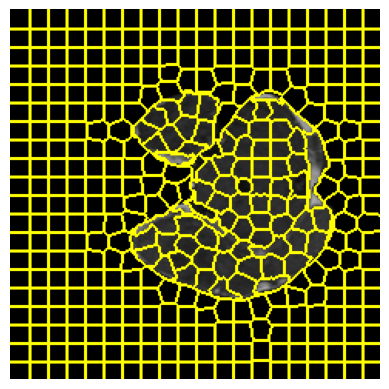

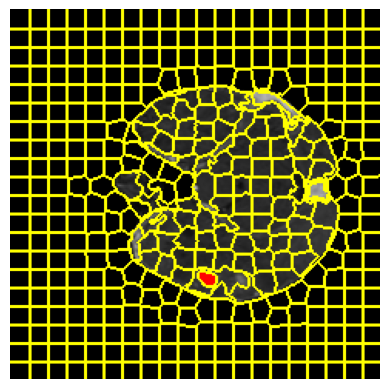

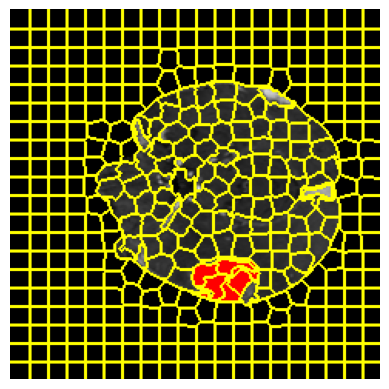

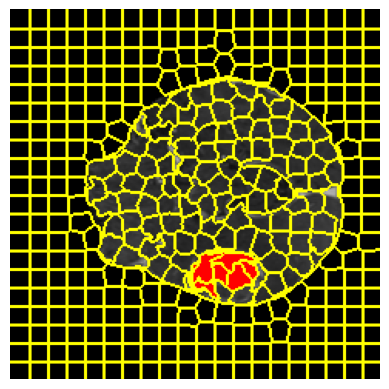

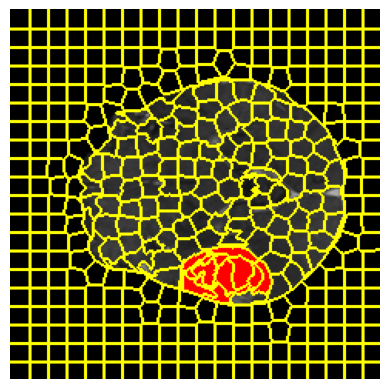

...

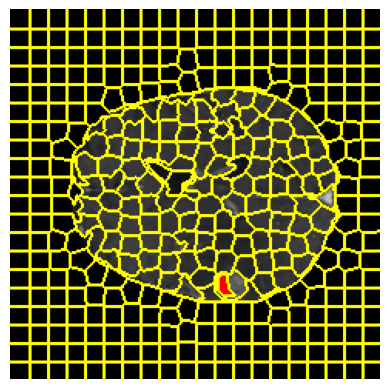

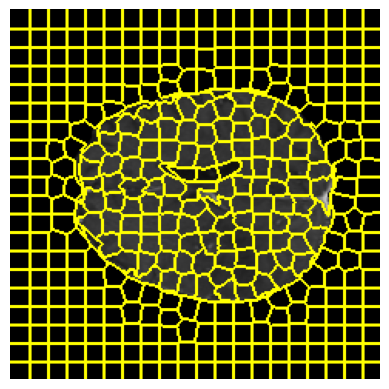

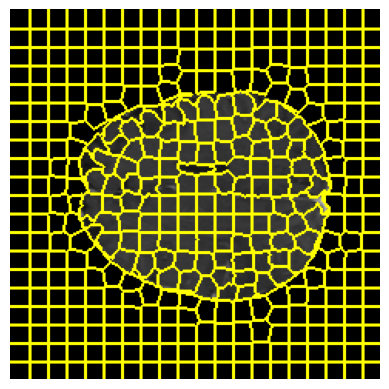

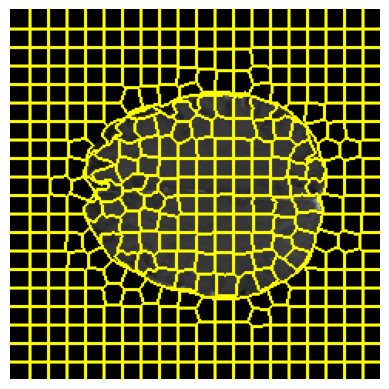

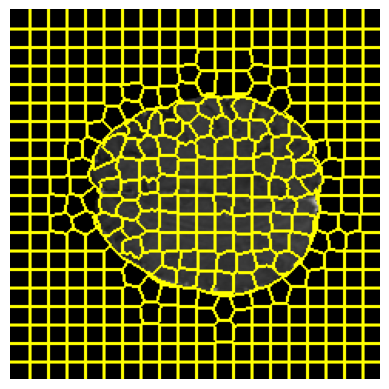

In [158]:
from skimage.segmentation import slic
from skimage.segmentation import mark_boundaries
from skimage.util import img_as_float
from skimage import io
import matplotlib.pyplot as plt
x = train_sample['image'][tio.DATA]

y = train_sample['label'][tio.DATA]

color_img = np.stack([x[0].cpu().detach().numpy()] * 3, axis=-1)
for i in range(2):
    color_mask[0, :, :, :, i] = y[0,i].cpu().detach().numpy()

mixed = color_img 
slices = np.stack(mixed[0, ..., range(40, 110, 5), :], axis=0)
slices.shape
numSegments = 375
label_slices = np.stack(y[0, ..., range(40, 110, 5)], axis=0)
label_slices = np.transpose(label_slices, (3, 1, 2, 0))
label_slices = label_slices[..., 1:2]

print(slices.shape)
print(label_slices.shape)
print(len(slices))
print(len(label_slices))
graphhhs=[]
slixcess=[ ]
for i, (slice, label_slice) in enumerate(zip(slices, label_slices)):
    
    segments = slic(slice, n_segments=numSegments, sigma=1)

    

    labled_stuff=labeled_segments(segments,label_slice,0.7)
    slice2=highlight_segments(slice, segments, labled_stuff)

    unique_segments = np.unique(segments)
    avg=average_color(slice, segments)  
    
    segments_to_highlight = high(unique_segments,slice,segments,avg)

    graphhhs.append(making_graph(slice, segments,segments_to_highlight,labled_stuff))
    slixcess.append(slice)
    fig = plt.figure("Superpixels -- %d segments" % (numSegments))
    ax = fig.add_subplot(1, 1, 1)
    ax.imshow(mark_boundaries(slice2, segments))
    plt.axis("off")
    plt.show()

In [159]:
from torch_geometric.data import Data
from torch_geometric.utils import from_networkx

# Convert NetworkX graphs to PyG graphs
pyg_graphhhhs = [from_networkx(g) for g in graphhhs]

In [214]:
new_graph_node_features=torch.cat((pyg_graphhhhs[5].area.unsqueeze(1), pyg_graphhhhs[5].intensity.unsqueeze(1)), dim=1)
new_graph_edge_index=pyg_graphhhhs[5].edge_index
with torch.no_grad():  # Disable gradient computation for inference
    predictions = model(new_graph_node_features, new_graph_edge_index)

probabilities = torch.softmax(predictions, dim=1)
predicted_class = probabilities.argmax(dim=1)

print("Predicted class probabilities:", probabilities)
print( predicted_class)

print( pyg_graphhhhs[5].label) 

Predicted class probabilities: tensor([[1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 2.0119e-26],
        [1.0000e+00, 2.8506e-21],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 3.8557e-08],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 9.3474e-10],
        [1.0000e+00, 1.8777e-43],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+00, 2.2711e-15],
        [1.0000e+00, 0.0000e+00],
        [1.0000e+